In [1]:
import wfdb
import os
import glob
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from scipy.signal import butter, filtfilt, iirnotch, sosfiltfilt, cheb2ord, cheby2, firwin, find_peaks
from sklearn.decomposition import FastICA
from scipy.interpolate import RectBivariateSpline
from scipy import interpolate
from scipy.ndimage import gaussian_filter
from scipy.optimize import curve_fit
from scipy.signal import welch
from sklearn.cluster import KMeans
from sklearn.preprocessing import normalize
from sklearn.preprocessing import MinMaxScaler
import matplotlib.animation as animation
import matplotlib.cm as cm
from IPython.display import HTML
from pyclustering.cluster.gmeans import gmeans
from pyclustering.cluster.xmeans import xmeans
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from pyclustering.utils.metric import type_metric, distance_metric
from sklearn.svm import SVC
import itertools
import json
from pathlib import Path
from collections.abc import Mapping
from typing import List, Sequence, Any, Optional
import hdbscan
import warnings
np.warnings = warnings

In [2]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
def get_virtual_emg(emg_data, virtual_bipolars):
  # --- データ読み込み ---
  emg_data = emg_data

  # === スライディングウィンドウ抽出 ===
  n_samples = emg_data.shape[0]
  segments = []
  time_stamps = []

  # 座標グリッド
  x = np.arange(8)
  y = np.arange(8)
  xv, yv = np.meshgrid(x, y)
  coords = np.vstack((xv.ravel(), yv.ravel()))
  # # パラメータ計算
  # f = RectBivariateSpline(x, y, map_2d)

  virtual_emg = []
  for i in range(n_samples):
    f = RectBivariateSpline(x, y, emg_data[i].reshape(8,8))
    z_list = []
    for bipolar in virtual_bipolars:
      x1=bipolar[0]
      y1=bipolar[1]
      x2=bipolar[2]
      y2=bipolar[3]
      z1 = f(x1, y1)
      z2 = f(x2, y2)
      z_diff = z1 - z2
      z_list.append(z_diff)
    virtual_emg.append(np.array(z_list).reshape(-1))
  virtual_emg = np.array(virtual_emg)

  # print(emg_data.shape)
  # print(virtual_emg.shape)

  return virtual_emg

In [4]:
def get_features(virtual_emg, labels, fs=2000, window_ms=50, stride_ms=20):
  # --- データ読み込み例（ここではダミーデータ） ---
  fs = fs  # サンプリング周波数
  window_ms = window_ms    # ウィンドウ幅 [ms]
  stride_ms = stride_ms    # スライド幅 [ms]
  window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
  stride_size = int(fs * stride_ms / 1000)  # スライド数
  n_samples = virtual_emg.shape[0]
  X = []
  y = []
  for start in range(0, n_samples - window_size + 1, stride_size):
      end = start + window_size
      window_emg = virtual_emg[start:end, :]
      #特徴量抽出
      rms = rms(window_emg) # shape: (virtual_bipolar_channels,)
      X.append(rms)
      y.append(labels)
  return X, y

In [5]:
#分類器
def SVC_classifier(X_session1, y_session1, X_session2, y_session2):

    X_train = np.array(X_session1).reshape(-1,1)
    y_train = np.array(y_session1).reshape(-1,1)
    X_test = np.array(X_session2).reshape(-1,1)
    y_test = np.array(y_session2).reshape(-1,1)

    # データ分割
    # X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # SVMモデル学習
    model = SVC(kernel='rbf', probability=True, random_state=0)
    model.fit(X_train, y_train)

    prob_matrix = model.predict_proba(X_test) # shape: (n_test_samples, n_train_classes)
    # === 各テストラベルごとに学習クラスへの平均確率を出力 ===
    class_labels = model.classes_  # 学習クラス（例: [0, 1, 2]）

    result = []

    for test_label in np.unique(y_test):
        idx = y_test.reshape(-1) == test_label
        mean_prob = np.mean(prob_matrix[idx], axis=0)  # 学習クラスへの平均確率
        result.append([test_label] + list(mean_prob))

    # # === 表形式で表示 ===
    # columns = ['Test Label'] + [f"P(Train={cls})" for cls in class_labels]
    # df_result = pd.DataFrame(result, columns=columns)
    # print(df_result)
    
    return result, y_train, y_test

In [6]:
def calc_diff(train_idx, test_idx, center_direction_session1, center_direction_session2):
    center_direction_session1 = center_direction_session1
    center_direction_session2 = center_direction_session2
    #計算
    center_x_train = np.array(center_direction_session1)[train_idx, 0]
    center_y_train = np.array(center_direction_session1)[train_idx, 1]
    theta_train = np.array(center_direction_session1)[train_idx, 2]
    center_x_test = np.array(center_direction_session2)[test_idx, 0]
    center_y_test = np.array(center_direction_session2)[test_idx, 1]
    theta_test = np.array(center_direction_session2)[test_idx, 2]
    center_x_diff = center_x_train - center_x_test
    center_y_diff = center_y_train - center_y_test
    theta_diff = theta_train - theta_test
    return center_x_diff, center_y_diff, theta_diff

In [7]:
def diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2):
  max_train_idx = []
  for i in range(np.array(result).shape[0]):
    j = np.argmax(np.array(result)[i,1:])
    max_train_idx.append(j)
  # print(max_train_idx)
  diff =[]
  for k in set(max_train_idx):
    if max_train_idx.count(k) >=2:
      idx = max_train_idx == k
      l = np.argmax(np.array(result)[idx, k+1], axis=0)
      max_test_idx = [i for i, j in enumerate(idx) if j == True]
      # print(f'result[{max_test_idx[l]},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_test_idx[l]]}')
      center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_test_idx[l], center_direction_session1, center_direction_session2)
      # print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
      diff.append({"train": np.unique(y_train)[k], "test": np.unique(y_test)[max_test_idx[l]], "x_diff": center_x_diff, "y_diff": center_y_diff, "theta_diff": theta_diff})
    else:
      # print(f'result[{max_train_idx.index(k)},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_train_idx.index(k)]}')
      center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_train_idx.index(k), center_direction_session1, center_direction_session2)
      # print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
      diff.append({"train": np.unique(y_train)[k], "test": np.unique(y_test)[max_train_idx.index(k)], "x_diff": center_x_diff, "y_diff": center_y_diff, "theta_diff": theta_diff})

  return diff

# 分析

## データ読み込み

In [8]:
# === ヘルパ ===
def _json_load_if_needed(x):
    """セル文字列がJSONならPythonオブジェクトに戻す。空欄/NaNはNone。"""
    if pd.isna(x):
        return None
    if isinstance(x, (list, dict)):
        return x
    if isinstance(x, str):
        s = x.strip()
        if s.startswith('[') or s.startswith('{') or s.startswith('"'):
            try:
                return json.loads(s)
            except Exception:
                return x  # JSONでなければそのまま
    return x

def load_records_from_csv(path, json_cols=None, numpy_cols=None, encoding='utf-8-sig'):
    """
    path: CSVパス（.gzなど圧縮もOK：compressionは自動推定）
    json_cols: JSON文字列として保存したカラム名のリスト（例: 配列/辞書）
    numpy_cols: その中でNumPy配列に戻したいカラム名（リスト→np.arrayへ）

    return: (df, records_list_of_dicts)
    """
    df = pd.read_csv(path, encoding=encoding)  # 圧縮は自動推定されます（.gzなど）
    json_cols = json_cols or []
    numpy_cols = numpy_cols or []

    # JSON復元
    for c in json_cols:
        if c in df.columns:
            df[c] = df[c].apply(_json_load_if_needed)

    # NumPy配列化
    for c in numpy_cols:
        if c in df.columns:
            df[c] = df[c].apply(lambda v: np.array(v) if isinstance(v, list) else v)

    return df, df.to_dict(orient='records')

# === 使い方1: Googleドライブに保存したCSVを読む ===
csv_path = 'output/vpolars/test0_ptp_gaussianfitting_kmeans43.csv'       # または 'records.csv.gz'
json_cols=['virtual_bipolars', 'labels', 'center_direction']
numpy_cols=['virtual_bipolars', 'center_direction']
df, records = load_records_from_csv(csv_path,json_cols=json_cols,numpy_cols=numpy_cols)
print('rows:', len(records))
# print(type(records[0]['emg_data']))  # <class 'numpy.ndarray'> を想定
df.head()

# === 使い方2: 手元PCからアップロードして読む ===
# from google.colab import files
# uploaded = files.upload()  # ダイアログでCSVを選択
# for name in uploaded.keys():
#     df, records = load_records_from_csv(
#         name,
#         json_cols=['emg_data', 'virtual_bipolars', 'labels', 'center_direction'],
#         numpy_cols=['emg_data', 'virtual_bipolars', 'center_direction']
#     )
#     print(name, 'rows:', len(records))
#     break  # 最初の1個だけ読みたい場合

rows: 8


,file_name,gesture,trial,subject,session,electrode_place,virtual_bipolars,labels,center_direction,n_virtual_bipolars
0,pr_dataset/subject01_session1/maintenance_prep...,1,1,1,1,ED,"[[6.296580538260699, 3.248731647215309, 6.9353...","[0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32]","[[6.615969670114207, 4.196355297434035, 71.374...",12
1,pr_dataset/subject01_session1/maintenance_prep...,1,1,1,1,EP,"[[1.8345724764340983, 5.527948941676875, 3.625...","[0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32]","[[2.7300998882123846, 5.082942588066408, -26.4...",12
2,pr_dataset/subject01_session1/maintenance_prep...,1,1,1,1,FD,"[[1.442327631433698, 5.379583809026659, 3.4387...","[0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32]","[[2.440521235428331, 5.439663164417722, 3.4443...",12
3,pr_dataset/subject01_session1/maintenance_prep...,1,1,1,1,FP,"[[6.060756768208424, 2.383147361773404, 7.1918...","[0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32]","[[6.6262816170342616, 3.2078786182203225, 55.5...",12
4,pr_dataset/subject01_session2/maintenance_prep...,1,1,1,2,ED,"[[-0.28601994511372797, 2.917444552463321, 1.1...","[0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32]","[[0.45684170518188383, 2.2479995819690464, -42...",12


In [9]:
vpolars = records

In [10]:
vpolars

[{'file_name': 'pr_dataset/subject01_session1/maintenance_preprocess_sample1',
  'gesture': 1,
  'trial': 1,
  'subject': 1,
  'session': 1,
  'electrode_place': 'ED',
  'virtual_bipolars': array([[6.29658054, 3.24873165, 6.9353588 , 5.14397895],
         [5.92960169, 4.87929407, 7.39765046, 3.52104785],
         [5.86347188, 5.39395533, 6.52672248, 3.50713297],
         [4.37581516, 1.36159177, 6.32303089, 1.8180465 ],
         [3.98348971, 2.97196001, 5.30025581, 1.46659393],
         [5.16335227, 3.46885005, 5.55584922, 1.50774166],
         [0.27916443, 2.06022004, 2.21720653, 2.5541763 ],
         [1.03613129, 1.14924311, 1.28223448, 3.13404366],
         [0.30921845, 2.84135228, 1.93986257, 1.68333684],
         [6.07865696, 6.96113284, 6.85958997, 5.11989858],
         [5.3072437 , 5.18867641, 5.99905007, 7.06521683],
         [4.54510775, 5.80587577, 6.47355189, 6.33606744]]),
  'labels': [0, 1, 2, 10, 11, 12, 20, 21, 22, 30, 31, 32],
  'center_direction': array([[  6.61596967,

In [11]:
# 標準化・正規化
def scaler(vpolars):
    x_list = []
    y_list = []
    theta_list = []
    for vpolar_list in vpolars:
        for vpolar in vpolar_list['center_direction']:
            x_list.append(vpolar[0])
            y_list.append(vpolar[1])
            theta_list.append(vpolar[2])
            # print(f"x: {vpolar[0]}, y: {vpolar[1]}, θ: {vpolar[2]}")
    # 標準化
    x_mean = np.mean(x_list)
    y_mean = np.mean(y_list)
    theta_mean = np.mean(theta_list)
    x_std = np.std(x_list)
    y_std = np.std(y_list)
    theta_std = np.std(theta_list)
    # 正規化
    x_max = np.max(x_list)
    x_min = np.min(x_list)
    y_max = np.max(y_list)
    y_min = np.min(y_list)
    theta_max = np.max(theta_list)
    theta_min = np.min(theta_list)
    return x_mean, y_mean, theta_mean, x_std, y_std, theta_std, x_max, x_min, y_max, y_min, theta_max, theta_min

In [12]:
# Δx, Δy, Δθ標準化のための平均値と標準偏差を計算
x_list = []
y_list = []
theta_list = []
for vpolar_list in vpolars:
    for vpolar in vpolar_list['center_direction']:
        x_list.append(vpolar[0])
        y_list.append(vpolar[1])
        theta_list.append(vpolar[2])
        # print(f"x: {vpolar[0]}, y: {vpolar[1]}, θ: {vpolar[2]}")
x_mean = np.mean(x_list)
y_mean = np.mean(y_list)
theta_mean = np.mean(theta_list)
x_std = np.std(x_list)
y_std = np.std(y_list)
theta_std = np.std(theta_list)
# 正規化
x_max = np.max(x_list)
x_min = np.min(x_list)
y_max = np.max(y_list)
y_min = np.min(y_list)
theta_max = np.max(theta_list)
theta_min = np.min(theta_list)

In [13]:
scaling = 2
distances = []
for list_session1 in vpolars:
    for list_session2 in vpolars:
        if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
            print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}')
            print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                for i in range(len(list_session1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_session2['center_direction'])):
                        x_distance[i].append(list_session2['center_direction'][j][0] - list_session1['center_direction'][i][0])
                        y_distance[i].append(list_session2['center_direction'][j][1] - list_session1['center_direction'][i][1])
                        theta_distance[i].append(list_session2['center_direction'][j][2] - list_session1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    if scaling == 0:
                        xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    elif scaling == 1:
                        # 標準化
                        x_norm = np.array(x_distance[i]) / x_std
                        y_norm = np.array(y_distance[i]) / y_std
                        theta_norm = np.array(theta_distance[i]) / theta_std
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    elif scaling == 2:
                        # min-max正規化
                        x_norm = np.array(x_distance[i]) / (x_max - x_min)
                        y_norm = np.array(y_distance[i]) / (y_max - y_min)
                        theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_session1['labels'][i],
                        'session2_cluster': list_session2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_session1['subject']}, gesture={list_session1['gesture']}, trial={list_session1['trial']}, electrode_place={list_session1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_session1['labels'][i]}, session2_cluster={list_session2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances.append({'subject': list_session1['subject'], 'gesture': list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place': list_session1['electrode_place'], 'result_distance': result_distance})
            

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 2
j=11,x_distance[0]: [-6.159127964932322, -6.046154997081723, -6.615533959239929, -0.05310563893311926, -0.42791617410556704, 0.13434467264116368, -1.4925322129609562, -2.1606043823129726, -0.7224922520892108, -3.953479073765544, -4.036859578023559, -3.7230930846529735], y_distance[0]: [-1.9483557154649889, -1.7271948478071217, 0.19430353227320918, 1.8346825918346443, 2.0219697192390162, 1.4715979464373277, 0.04900967616398688, 0.29615671849881675, -0.1823341628839268, -3.5130957331577433, -3.2750014078058993, -2.5462744511762185], theta_distance[0]: [-113.39825560339926, -26.31367332264248, -73.07944663313141, -149.3762992113093, -17.43649553082691, -124.0596554040559, -153.4212276258581, 12.135338217013881, -119.18908148867413, -120.79569666871714, -68.

In [14]:
distances

[{'subject': 1,
  'gesture': 1,
  'trial': 1,
  'electrode_place': 'ED',
  'result_distance': [{'session1_cluster': 0,
    'session2_cluster': 21,
    'x_distance': -2.1606043823129726,
    'y_distance': 0.29615671849881675,
    'theta_distance': 12.135338217013881},
   {'session1_cluster': 1,
    'session2_cluster': 22,
    'x_distance': -0.7701486554193808,
    'y_distance': -0.18614982527023027,
    'theta_distance': -5.039909615073448},
   {'session1_cluster': 2,
    'session2_cluster': 22,
    'x_distance': -0.3016197620991692,
    'y_distance': -0.4365230172274561,
    'theta_distance': 22.817477825835134},
   {'session1_cluster': 10,
    'session2_cluster': 31,
    'x_distance': -2.7703129355428024,
    'y_distance': -0.668465245799285,
    'theta_distance': -10.08859438679247},
   {'session1_cluster': 11,
    'session2_cluster': 22,
    'x_distance': 1.251604660319428,
    'y_distance': 1.7947441643320072,
    'theta_distance': 1.0082612333665608},
   {'session1_cluster': 12,
 

## 各subjectでの分析

In [15]:
def distances_across_sessions(vpolars, scaling=2, x_std=x_std, y_std=y_std, theta_std=theta_std, x_max=x_max, x_min=x_min, y_max=y_max, y_min=y_min, theta_max=theta_max, theta_min=theta_min):
    distances = []
    for list_session1 in vpolars:
        for list_session2 in vpolars:
            if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
                # print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}')
                # print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}')
                x_distance = {}
                y_distance = {}
                theta_distance = {}
                result_distance = []
                if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                    for i in range(len(list_session1['center_direction'])):
                        x_distance[i] = []
                        y_distance[i] = []
                        theta_distance[i] = []
                        for j in range(len(list_session2['center_direction'])):
                            x_distance[i].append(list_session2['center_direction'][j][0] - list_session1['center_direction'][i][0])
                            y_distance[i].append(list_session2['center_direction'][j][1] - list_session1['center_direction'][i][1])
                            theta_distance[i].append(list_session2['center_direction'][j][2] - list_session1['center_direction'][i][2])
                        # print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                        if scaling == 0:
                            xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                        elif scaling == 1:
                            # 標準化
                            x_norm = np.array(x_distance[i]) / x_std
                            y_norm = np.array(y_distance[i]) / y_std
                            theta_norm = np.array(theta_distance[i]) / theta_std
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        elif scaling == 2:
                            # min-max正規化
                            x_norm = np.array(x_distance[i]) / (x_max - x_min)
                            y_norm = np.array(y_distance[i]) / (y_max - y_min)
                            theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        session2_id = np.argmin(xy_distance) #最小値のインデックス
                        result_distance.append({
                            'session1_cluster': list_session1['labels'][i],
                            'session2_cluster': list_session2['labels'][session2_id],
                            'x_distance': x_distance[i][session2_id],
                            'y_distance': y_distance[i][session2_id],
                            'theta_distance': theta_distance[i][session2_id]
                        })
                        # print(f"subject={list_session1['subject']}, gesture={list_session1['gesture']}, trial={list_session1['trial']}, electrode_place={list_session1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_session1['labels'][i]}, session2_cluster={list_session2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
                else:
                    result_distance.append(None)
                distances.append({'subject': list_session1['subject'], 'gesture': list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place': list_session1['electrode_place'], 'result_distance': result_distance})
    return distances
    # n_sessions_list = []
    # for distance in distances:
    #     n_sessions_list.append(distance['subject'])
    # subjects = set(n_sessions_list)

    # x_ED_gesture = {}
    # y_ED_gesture = {}
    # theta_ED_gesture = {}
    # x_EP_gesture = {}
    # y_EP_gesture = {}
    # theta_EP_gesture = {}
    # x_FD_gesture = {}
    # y_FD_gesture = {}
    # theta_FD_gesture = {}
    # x_FP_gesture = {}
    # y_FP_gesture = {}
    # theta_FP_gesture = {}
    # n_gestures = 34
    # for subject in subjects:
    #     x_ED_gesture[subject] = {}
    #     y_ED_gesture[subject] = {}
    #     theta_ED_gesture[subject] = {}
    #     x_EP_gesture[subject] = {}
    #     y_EP_gesture[subject] = {}
    #     theta_EP_gesture[subject] = {}
    #     x_FD_gesture[subject] = {}
    #     y_FD_gesture[subject] = {}
    #     theta_FD_gesture[subject] = {}
    #     x_FP_gesture[subject] = {}
    #     y_FP_gesture[subject] = {}
    #     theta_FP_gesture[subject] = {}
    #     for i in range(n_gestures):
    #         x_ED_gesture[subject][i+1] = []
    #         y_ED_gesture[subject][i+1] = []
    #         theta_ED_gesture[subject][i+1] = []
    #         x_EP_gesture[subject][i+1] = []
    #         y_EP_gesture[subject][i+1] = []
    #         theta_EP_gesture[subject][i+1] = []
    #         x_FD_gesture[subject][i+1] = []
    #         y_FD_gesture[subject][i+1] = []
    #         theta_FD_gesture[subject][i+1] = []
    #         x_FP_gesture[subject][i+1] = []
    #         y_FP_gesture[subject][i+1] = []
    #         theta_FP_gesture[subject][i+1] = []
    # for diff_list in distances:
    #     # print(diff_list)
    #     if diff_list['result_distance'] != [None]:
    #         subject = diff_list['subject']
    #         gesture = int(diff_list['gesture'])
    #         electrode_place = diff_list['electrode_place']
    #         if electrode_place == 'ED':
    #             for diff in diff_list['result_distance']:
    #                 x_ED_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_ED_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'EP':
    #             for diff in diff_list['result_distance']:
    #                 x_EP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_EP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FD':
    #             for diff in diff_list['result_distance']:
    #                 x_FD_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FD_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FP':
    #             for diff in diff_list['result_distance']:
    #                 x_FP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FP_gesture[subject][gesture].append(diff['theta_distance'])
    # # 差分の絶対値
    # x_gesture_mean = {}
    # y_gesture_mean = {}
    # theta_gesture_mean = {}
    # for subject in subjects:
    #     x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     for i in range(n_gestures):
    #         for l in range(len(x_ED_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
    #         for l in range(len(x_EP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
    #         for l in range(len(x_FD_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
    #         for l in range(len(x_FP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    #     x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    #     x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])
    # # 表の作成
    # rows = []
    # for subject in subjects:
    #     rows.append([subject, 
    #                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
    #                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
    #                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
    # abs_df = pd.DataFrame(rows, columns=['Subject', 
    #                                     'x_mean', 'x_std', 'y_mean', 'y_std',
    #                                     'theta_mean', 'theta_std'])
    # # ジェスチャーごとの差分の絶対値
    # n_gestures_list = []
    # for distance in distances:
    #     n_gestures_list.append(int(distance['gesture']))
    # gestures = set(n_gestures_list)

    # x_gesture_mean = {}
    # y_gesture_mean = {}
    # theta_gesture_mean = {}
    # for gesture in gestures:
    #     x_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    #     y_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    #     theta_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    #     for subject in subjects:
    #         for l in range(len(x_ED_gesture[subject][gesture])):
    #             x_gesture_mean[gesture]['value'].append(np.abs(x_ED_gesture[subject][gesture][l]))
    #             y_gesture_mean[gesture]['value'].append(np.abs(y_ED_gesture[subject][gesture][l]))
    #             theta_gesture_mean[gesture]['value'].append(np.abs(theta_ED_gesture[subject][gesture][l]))
    #         for l in range(len(x_EP_gesture[subject][gesture])):
    #             x_gesture_mean[gesture]['value'].append(np.abs(x_EP_gesture[subject][gesture][l]))
    #             y_gesture_mean[gesture]['value'].append(np.abs(y_EP_gesture[subject][gesture][l]))
    #             theta_gesture_mean[gesture]['value'].append(np.abs(theta_EP_gesture[subject][gesture][l]))
    #         for l in range(len(x_FD_gesture[subject][gesture])):
    #             x_gesture_mean[gesture]['value'].append(np.abs(x_FD_gesture[subject][gesture][l]))
    #             y_gesture_mean[gesture]['value'].append(np.abs(y_FD_gesture[subject][gesture][l]))
    #             theta_gesture_mean[gesture]['value'].append(np.abs(theta_FD_gesture[subject][gesture][l]))
    #         for l in range(len(x_FP_gesture[subject][gesture])):
    #             x_gesture_mean[gesture]['value'].append(np.abs(x_FP_gesture[subject][gesture][l]))
    #             y_gesture_mean[gesture]['value'].append(np.abs(y_FP_gesture[subject][gesture][l]))
    #             theta_gesture_mean[gesture]['value'].append(np.abs(theta_FP_gesture[subject][gesture][l]))
    #     x_gesture_mean[gesture]['mean'] = np.mean(x_gesture_mean[gesture]['value'])
    #     x_gesture_mean[gesture]['std'] = np.std(x_gesture_mean[gesture]['value'])
    #     y_gesture_mean[gesture]['mean'] = np.mean(y_gesture_mean[gesture]['value'])
    #     y_gesture_mean[gesture]['std'] = np.std(y_gesture_mean[gesture]['value'])
    #     theta_gesture_mean[gesture]['mean'] = np.mean(theta_gesture_mean[gesture]['value'])
    #     theta_gesture_mean[gesture]['std'] = np.std(theta_gesture_mean[gesture]['value'])
    # # 表の作成
    # rows = []
    # for gesture in gestures:
    #     rows.append([gesture, 
    #                 x_gesture_mean[gesture]['mean'], x_gesture_mean[gesture]['std'],
    #                 y_gesture_mean[gesture]['mean'], y_gesture_mean[gesture]['std'],
    #                 theta_gesture_mean[gesture]['mean'], theta_gesture_mean[gesture]['std']])
    # gesture_df = pd.DataFrame(rows, columns=['Gesture', 
    #                                     'x_mean', 'x_std', 'y_mean', 'y_std',
    #                                     'theta_mean', 'theta_std'])
    # return abs_df, gesture_df

In [16]:
def distances_across_trials(vpolars, scaling=2, x_std=x_std, y_std=y_std, theta_std=theta_std, x_max=x_max, x_min=x_min, y_max=y_max, y_min=y_min, theta_max=theta_max, theta_min=theta_min):
    distances_between_trials = []
    for list_1 in vpolars:
        for list_2 in vpolars:
            if list_1['subject'] == list_2['subject'] and list_1['session'] == list_2['session']  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] == 1 and list_2['trial'] == 2 and list_1['electrode_place'] == list_2['electrode_place']:
                # print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
                # print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
                x_distance = {}
                y_distance = {}
                theta_distance = {}
                result_distance = []
                if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                    for i in range(len(list_1['center_direction'])):
                        x_distance[i] = []
                        y_distance[i] = []
                        theta_distance[i] = []
                        for j in range(len(list_2['center_direction'])):
                            x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                            y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                            theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                        # print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                        if scaling == 0:
                            xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                        elif scaling == 1:
                            # 標準化
                            x_norm = np.array(x_distance[i]) / x_std
                            y_norm = np.array(y_distance[i]) / y_std
                            theta_norm = np.array(theta_distance[i]) / theta_std
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        elif scaling == 2:
                            # min-max正規化
                            x_norm = np.array(x_distance[i]) / (x_max - x_min)
                            y_norm = np.array(y_distance[i]) / (y_max - y_min)
                            theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        session2_id = np.argmin(xy_distance) #最小値のインデックス
                        result_distance.append({
                            'session1_cluster': list_1['labels'][i],
                            'session2_cluster': list_2['labels'][session2_id],
                            'x_distance': x_distance[i][session2_id],
                            'y_distance': y_distance[i][session2_id],
                            'theta_distance': theta_distance[i][session2_id]
                        })
                        # print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
                else:
                    result_distance.append(None)
                distances_between_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})
    return distances_between_trials
    # n_sessions_list = []
    # for distance in distances_between_trials:
    #     n_sessions_list.append(distance['subject'])
    # subjects = set(n_sessions_list)

    # x_ED_gesture = {}
    # y_ED_gesture = {}
    # theta_ED_gesture = {}
    # x_EP_gesture = {}
    # y_EP_gesture = {}
    # theta_EP_gesture = {}
    # x_FD_gesture = {}
    # y_FD_gesture = {}
    # theta_FD_gesture = {}
    # x_FP_gesture = {}
    # y_FP_gesture = {}
    # theta_FP_gesture = {}
    # n_gestures = 34
    # for subject in subjects:
    #     x_ED_gesture[subject] = {}
    #     y_ED_gesture[subject] = {}
    #     theta_ED_gesture[subject] = {}
    #     x_EP_gesture[subject] = {}
    #     y_EP_gesture[subject] = {}
    #     theta_EP_gesture[subject] = {}
    #     x_FD_gesture[subject] = {}
    #     y_FD_gesture[subject] = {}
    #     theta_FD_gesture[subject] = {}
    #     x_FP_gesture[subject] = {}
    #     y_FP_gesture[subject] = {}
    #     theta_FP_gesture[subject] = {}
    #     for i in range(n_gestures):
    #         x_ED_gesture[subject][i+1] = []
    #         y_ED_gesture[subject][i+1] = []
    #         theta_ED_gesture[subject][i+1] = []
    #         x_EP_gesture[subject][i+1] = []
    #         y_EP_gesture[subject][i+1] = []
    #         theta_EP_gesture[subject][i+1] = []
    #         x_FD_gesture[subject][i+1] = []
    #         y_FD_gesture[subject][i+1] = []
    #         theta_FD_gesture[subject][i+1] = []
    #         x_FP_gesture[subject][i+1] = []
    #         y_FP_gesture[subject][i+1] = []
    #         theta_FP_gesture[subject][i+1] = []

    # for diff_list in distances_between_trials:
    #     # print(diff_list)
    #     if diff_list['result_distance'] != [None]:
    #         subject = diff_list['subject']
    #         gesture = int(diff_list['gesture'])
    #         electrode_place = diff_list['electrode_place']
    #         if electrode_place == 'ED':
    #             for diff in diff_list['result_distance']:
    #                 x_ED_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_ED_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'EP':
    #             for diff in diff_list['result_distance']:
    #                 x_EP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_EP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FD':
    #             for diff in diff_list['result_distance']:
    #                 x_FD_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FD_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FP':
    #             for diff in diff_list['result_distance']:
    #                 x_FP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

    # x_gesture_mean = {}
    # y_gesture_mean = {}
    # theta_gesture_mean = {}
    # for subject in subjects:
    #     x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     for i in range(n_gestures):
    #         for l in range(len(x_ED_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
    #         for l in range(len(x_EP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
    #         for l in range(len(x_FD_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
    #         for l in range(len(x_FP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    #     x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    #     x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

    #     # 表の作成
    # rows = []
    # for subject in subjects:
    #     rows.append([subject, 
    #                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
    #                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
    #                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
    # mean_std_df = pd.DataFrame(rows, columns=['Subject', 
    #                                     'x_mean', 'x_std', 'y_mean', 'y_std',
    #                                     'theta_mean', 'theta_std'])
    # return mean_std_df

In [17]:
def distances_across_sessions_and_trials(vpolars, scaling=2, x_std=x_std, y_std=y_std, theta_std=theta_std, x_max=x_max, x_min=x_min, y_max=y_max, y_min=y_min, theta_max=theta_max, theta_min=theta_min):
    distances_across_session_trials = []
    for list_1 in vpolars:
        for list_2 in vpolars:
            if list_1['subject'] == list_2['subject'] and list_1['session'] == 1 and list_2['session'] == 2  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] != list_2['trial'] and list_1['electrode_place'] == list_2['electrode_place']:
                # print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
                # print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
                x_distance = {}
                y_distance = {}
                theta_distance = {}
                result_distance = []
                if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                    for i in range(len(list_1['center_direction'])):
                        x_distance[i] = []
                        y_distance[i] = []
                        theta_distance[i] = []
                        for j in range(len(list_2['center_direction'])):
                            x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                            y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                            theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                        # print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                        if scaling == 0:
                            xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                        elif scaling == 1:
                            # 標準化
                            x_norm = np.array(x_distance[i]) / x_std
                            y_norm = np.array(y_distance[i]) / y_std
                            theta_norm = np.array(theta_distance[i]) / theta_std
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        elif scaling == 2:
                            # min-max正規化
                            x_norm = np.array(x_distance[i]) / (x_max - x_min)
                            y_norm = np.array(y_distance[i]) / (y_max - y_min)
                            theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                            xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                        session2_id = np.argmin(xy_distance) #最小値のインデックス
                        result_distance.append({
                            'session1_cluster': list_1['labels'][i],
                            'session2_cluster': list_2['labels'][session2_id],
                            'x_distance': x_distance[i][session2_id],
                            'y_distance': y_distance[i][session2_id],
                            'theta_distance': theta_distance[i][session2_id]
                        })
                        # print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
                else:
                    result_distance.append(None)
                distances_across_session_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})
    return distances_across_session_trials
    # n_sessions_list = []
    # for distance in distances_across_session_trials:
    #     n_sessions_list.append(distance['subject'])
    # subjects = set(n_sessions_list)

    # x_ED_gesture = {}
    # y_ED_gesture = {}
    # theta_ED_gesture = {}
    # x_EP_gesture = {}
    # y_EP_gesture = {}
    # theta_EP_gesture = {}
    # x_FD_gesture = {}
    # y_FD_gesture = {}
    # theta_FD_gesture = {}
    # x_FP_gesture = {}
    # y_FP_gesture = {}
    # theta_FP_gesture = {}
    # n_gestures = 34
    # for subject in subjects:
    #     x_ED_gesture[subject] = {}
    #     y_ED_gesture[subject] = {}
    #     theta_ED_gesture[subject] = {}
    #     x_EP_gesture[subject] = {}
    #     y_EP_gesture[subject] = {}
    #     theta_EP_gesture[subject] = {}
    #     x_FD_gesture[subject] = {}
    #     y_FD_gesture[subject] = {}
    #     theta_FD_gesture[subject] = {}
    #     x_FP_gesture[subject] = {}
    #     y_FP_gesture[subject] = {}
    #     theta_FP_gesture[subject] = {}
    #     for i in range(n_gestures):
    #         x_ED_gesture[subject][i+1] = []
    #         y_ED_gesture[subject][i+1] = []
    #         theta_ED_gesture[subject][i+1] = []
    #         x_EP_gesture[subject][i+1] = []
    #         y_EP_gesture[subject][i+1] = []
    #         theta_EP_gesture[subject][i+1] = []
    #         x_FD_gesture[subject][i+1] = []
    #         y_FD_gesture[subject][i+1] = []
    #         theta_FD_gesture[subject][i+1] = []
    #         x_FP_gesture[subject][i+1] = []
    #         y_FP_gesture[subject][i+1] = []
    #         theta_FP_gesture[subject][i+1] = []
    # for diff_list in distances_across_session_trials:
    #     # print(diff_list)
    #     if diff_list['result_distance'] != [None]:
    #         subject = diff_list['subject']
    #         gesture = int(diff_list['gesture'])
    #         electrode_place = diff_list['electrode_place']
    #         if electrode_place == 'ED':
    #             for diff in diff_list['result_distance']:
    #                 x_ED_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_ED_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'EP':
    #             for diff in diff_list['result_distance']:
    #                 x_EP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_EP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FD':
    #             for diff in diff_list['result_distance']:
    #                 x_FD_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FD_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
    #         elif electrode_place == 'FP':
    #             for diff in diff_list['result_distance']:
    #                 x_FP_gesture[subject][gesture].append(diff['x_distance'])
    #                 y_FP_gesture[subject][gesture].append(diff['y_distance'])
    #                 theta_FP_gesture[subject][gesture].append(diff['theta_distance'])
    # x_gesture_mean = {}
    # y_gesture_mean = {}
    # theta_gesture_mean = {}
    # for subject in subjects:
    #     x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    #     for i in range(n_gestures):
    #         for l in range(len(x_ED_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
    #         for l in range(len(x_EP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
    #         for l in range(len(x_FD_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
    #         for l in range(len(x_FP_gesture[subject][i+1])):
    #             x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
    #             y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
    #             theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    #     x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    #     x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    #     y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    #     theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])
    # # 表の作成
    # rows = []
    # for subject in subjects:
    #     rows.append([subject, 
    #                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
    #                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
    #                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
    # mean_std_df = pd.DataFrame(rows, columns=['Subject', 
    #                                     'x_mean', 'x_std', 'y_mean', 'y_std',
    #                                     'theta_mean', 'theta_std'])
    # return mean_std_df

In [18]:
def df_maker(distances):
    n_sessions_list = []
    for distance in distances:
        n_sessions_list.append(distance['subject'])
    subjects = set(n_sessions_list)

    x_ED_gesture = {}
    y_ED_gesture = {}
    theta_ED_gesture = {}
    x_EP_gesture = {}
    y_EP_gesture = {}
    theta_EP_gesture = {}
    x_FD_gesture = {}
    y_FD_gesture = {}
    theta_FD_gesture = {}
    x_FP_gesture = {}
    y_FP_gesture = {}
    theta_FP_gesture = {}
    n_gestures = 34
    for subject in subjects:
        x_ED_gesture[subject] = {}
        y_ED_gesture[subject] = {}
        theta_ED_gesture[subject] = {}
        x_EP_gesture[subject] = {}
        y_EP_gesture[subject] = {}
        theta_EP_gesture[subject] = {}
        x_FD_gesture[subject] = {}
        y_FD_gesture[subject] = {}
        theta_FD_gesture[subject] = {}
        x_FP_gesture[subject] = {}
        y_FP_gesture[subject] = {}
        theta_FP_gesture[subject] = {}
        for i in range(n_gestures):
            x_ED_gesture[subject][i+1] = []
            y_ED_gesture[subject][i+1] = []
            theta_ED_gesture[subject][i+1] = []
            x_EP_gesture[subject][i+1] = []
            y_EP_gesture[subject][i+1] = []
            theta_EP_gesture[subject][i+1] = []
            x_FD_gesture[subject][i+1] = []
            y_FD_gesture[subject][i+1] = []
            theta_FD_gesture[subject][i+1] = []
            x_FP_gesture[subject][i+1] = []
            y_FP_gesture[subject][i+1] = []
            theta_FP_gesture[subject][i+1] = []
    for diff_list in distances:
        # print(diff_list)
        if diff_list['result_distance'] != [None]:
            subject = diff_list['subject']
            gesture = int(diff_list['gesture'])
            electrode_place = diff_list['electrode_place']
            if electrode_place == 'ED':
                for diff in diff_list['result_distance']:
                    x_ED_gesture[subject][gesture].append(diff['x_distance'])
                    y_ED_gesture[subject][gesture].append(diff['y_distance'])
                    theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
            elif electrode_place == 'EP':
                for diff in diff_list['result_distance']:
                    x_EP_gesture[subject][gesture].append(diff['x_distance'])
                    y_EP_gesture[subject][gesture].append(diff['y_distance'])
                    theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
            elif electrode_place == 'FD':
                for diff in diff_list['result_distance']:
                    x_FD_gesture[subject][gesture].append(diff['x_distance'])
                    y_FD_gesture[subject][gesture].append(diff['y_distance'])
                    theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
            elif electrode_place == 'FP':
                for diff in diff_list['result_distance']:
                    x_FP_gesture[subject][gesture].append(diff['x_distance'])
                    y_FP_gesture[subject][gesture].append(diff['y_distance'])
                    theta_FP_gesture[subject][gesture].append(diff['theta_distance'])
    # 差分の絶対値
    x_gesture_mean = {}
    y_gesture_mean = {}
    theta_gesture_mean = {}
    for subject in subjects:
        x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
        y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
        theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
        for i in range(n_gestures):
            for l in range(len(x_ED_gesture[subject][i+1])):
                x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
                y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
                theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
            for l in range(len(x_EP_gesture[subject][i+1])):
                x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
                y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
                theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
            for l in range(len(x_FD_gesture[subject][i+1])):
                x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
                y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
                theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
            for l in range(len(x_FP_gesture[subject][i+1])):
                x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
                y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
                theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
        x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
        x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
        y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
        y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
        theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
        theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])
    # 表の作成
    rows = []
    for subject in subjects:
        rows.append([subject, 
                    x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                    y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                    theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
    abs_df = pd.DataFrame(rows, columns=['Subject', 
                                        'x_mean', 'x_std', 'y_mean', 'y_std',
                                        'theta_mean', 'theta_std'])
    # ジェスチャーごとの差分の絶対値
    n_gestures_list = []
    for distance in distances:
        n_gestures_list.append(int(distance['gesture']))
    gestures = set(n_gestures_list)

    x_gesture_mean = {}
    y_gesture_mean = {}
    theta_gesture_mean = {}
    for gesture in gestures:
        x_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
        y_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
        theta_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
        for subject in subjects:
            for l in range(len(x_ED_gesture[subject][gesture])):
                x_gesture_mean[gesture]['value'].append(np.abs(x_ED_gesture[subject][gesture][l]))
                y_gesture_mean[gesture]['value'].append(np.abs(y_ED_gesture[subject][gesture][l]))
                theta_gesture_mean[gesture]['value'].append(np.abs(theta_ED_gesture[subject][gesture][l]))
            for l in range(len(x_EP_gesture[subject][gesture])):
                x_gesture_mean[gesture]['value'].append(np.abs(x_EP_gesture[subject][gesture][l]))
                y_gesture_mean[gesture]['value'].append(np.abs(y_EP_gesture[subject][gesture][l]))
                theta_gesture_mean[gesture]['value'].append(np.abs(theta_EP_gesture[subject][gesture][l]))
            for l in range(len(x_FD_gesture[subject][gesture])):
                x_gesture_mean[gesture]['value'].append(np.abs(x_FD_gesture[subject][gesture][l]))
                y_gesture_mean[gesture]['value'].append(np.abs(y_FD_gesture[subject][gesture][l]))
                theta_gesture_mean[gesture]['value'].append(np.abs(theta_FD_gesture[subject][gesture][l]))
            for l in range(len(x_FP_gesture[subject][gesture])):
                x_gesture_mean[gesture]['value'].append(np.abs(x_FP_gesture[subject][gesture][l]))
                y_gesture_mean[gesture]['value'].append(np.abs(y_FP_gesture[subject][gesture][l]))
                theta_gesture_mean[gesture]['value'].append(np.abs(theta_FP_gesture[subject][gesture][l]))
        x_gesture_mean[gesture]['mean'] = np.mean(x_gesture_mean[gesture]['value'])
        x_gesture_mean[gesture]['std'] = np.std(x_gesture_mean[gesture]['value'])
        y_gesture_mean[gesture]['mean'] = np.mean(y_gesture_mean[gesture]['value'])
        y_gesture_mean[gesture]['std'] = np.std(y_gesture_mean[gesture]['value'])
        theta_gesture_mean[gesture]['mean'] = np.mean(theta_gesture_mean[gesture]['value'])
        theta_gesture_mean[gesture]['std'] = np.std(theta_gesture_mean[gesture]['value'])
    # 表の作成
    rows = []
    for gesture in gestures:
        rows.append([gesture, 
                    x_gesture_mean[gesture]['mean'], x_gesture_mean[gesture]['std'],
                    y_gesture_mean[gesture]['mean'], y_gesture_mean[gesture]['std'],
                    theta_gesture_mean[gesture]['mean'], theta_gesture_mean[gesture]['std']])
    gesture_df = pd.DataFrame(rows, columns=['Gesture', 
                                        'x_mean', 'x_std', 'y_mean', 'y_std',
                                        'theta_mean', 'theta_std'])
    return abs_df, gesture_df

In [19]:
df1, df2 = distances_across_sessions(vpolars, scaling=2)
df1

ValueError: too many values to unpack (expected 2)

In [20]:
df2

NameError: name 'df2' is not defined

In [ ]:
df = distances_across_trials(vpolars, scaling=2)
df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.442738,0.436845,0.580743,0.579646,10.522177,11.060236


In [ ]:
df = distances_across_sessions_and_trials(vpolars, scaling=2)
df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.595128,0.550685,0.588572,0.506214,12.304803,11.727495


# a

In [21]:
distances= distances_across_sessions(vpolars, scaling=2)
abs_df, gesture_df = df_maker(distances)
abs_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.638519,0.614509,0.601192,0.512182,13.024456,12.875585


In [22]:
gesture_df

,Gesture,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.638519,0.614509,0.601192,0.512182,13.024456,12.875585


In [23]:
distances= distances_across_trials(vpolars, scaling=2)
abs_df, gesture_df = df_maker(distances)
abs_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std


In [24]:
gesture_df

,Gesture,x_mean,x_std,y_mean,y_std,theta_mean,theta_std


In [25]:
distances = distances_across_sessions_and_trials(vpolars, scaling=2)
df1, df2 = df_maker(distances)
df1

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std


In [26]:
df2

,Gesture,x_mean,x_std,y_mean,y_std,theta_mean,theta_std


In [14]:
n_sessions_list = []
for distance in distances:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [17]:
for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': 1, 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 11, 'x_distance': -0.42791617410556704, 'y_distance': 2.0219697192390162, 'theta_distance': -17.43649553082691}, {'session1_cluster': 1, 'session2_cluster': 22, 'x_distance': -0.7701486554193808, 'y_distance': -0.18614982527023027, 'theta_distance': -5.039909615073448}, {'session1_cluster': 2, 'session2_cluster': 22, 'x_distance': -0.3016197620991692, 'y_distance': -0.4365230172274561, 'theta_distance': 22.817477825835134}, {'session1_cluster': 10, 'session2_cluster': 31, 'x_distance': -2.7703129355428024, 'y_distance': -0.668465245799285, 'theta_distance': -10.08859438679247}, {'session1_cluster': 11, 'session2_cluster': 22, 'x_distance': 1.251604660319428, 'y_distance': 1.7947441643320072, 'theta_distance': 1.0082612333665608}, {'session1_cluster': 12, 'session2_cluster': 20, 'x_distance': -0.23616328597617464, 'y_distance': 1.7570691176885251, 'theta_dist

In [200]:
ED_xy_list = {}
EP_xy_list = {}
FD_xy_list = {}
FP_xy_list = {}
for subject in subjects:
    ED_xy_list[subject] = []
    EP_xy_list[subject] = []
    FD_xy_list[subject] = []
    FP_xy_list[subject] = []
    for i in range(n_gestures):
        # ED
        ED_xy_list[subject].append(x_ED_gesture[subject][i+1])
        ED_xy_list[subject].append(y_ED_gesture[subject][i+1])
        # EP
        EP_xy_list[subject].append(x_EP_gesture[subject][i+1])
        EP_xy_list[subject].append(y_EP_gesture[subject][i+1])
        # FD
        FD_xy_list[subject].append(x_FD_gesture[subject][i+1])
        FD_xy_list[subject].append(y_FD_gesture[subject][i+1])
        # FP
        FP_xy_list[subject].append(x_FP_gesture[subject][i+1])
        FP_xy_list[subject].append(y_FP_gesture[subject][i+1])

ED_theta_list = {}
EP_theta_list = {}
FD_theta_list = {}
FP_theta_list = {}
for subject in subjects:
    ED_theta_list[subject] = []
    EP_theta_list[subject] = []
    FD_theta_list[subject] = []
    FP_theta_list[subject] = []
    for i in range(n_gestures):
        # ED
        ED_theta_list[subject].append(theta_ED_gesture[subject][i+1])
        # EP
        EP_theta_list[subject].append(theta_EP_gesture[subject][i+1])
        # FD
        FD_theta_list[subject].append(theta_FD_gesture[subject][i+1])
        # FP
        FP_theta_list[subject].append(theta_FP_gesture[subject][i+1])

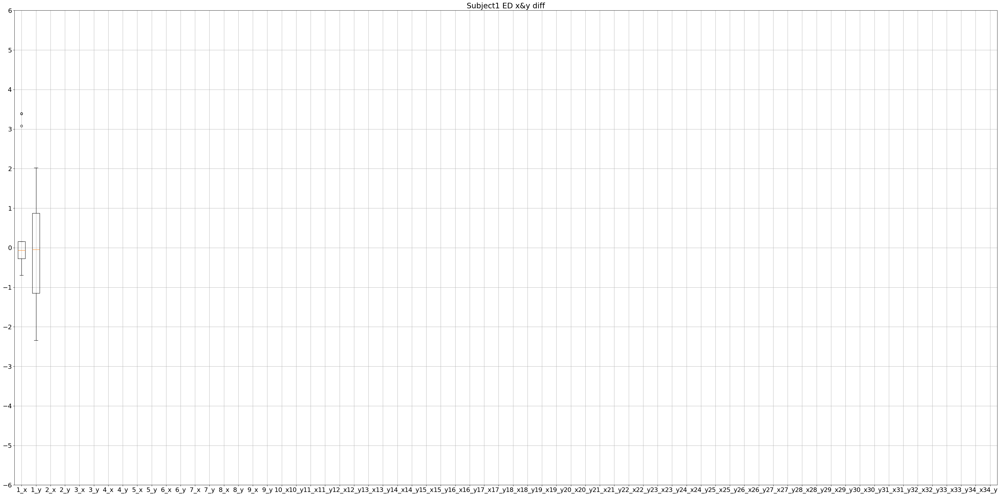

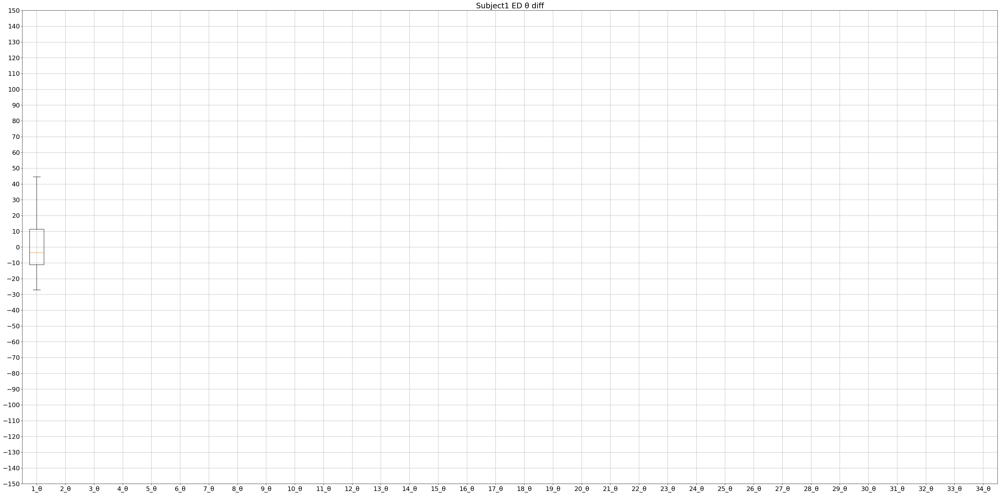

In [201]:
for subject in subjects:
    fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
    ax.boxplot(ED_xy_list[subject])
    ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
    plt.title('Subject'+str(subject)+' ED x&y diff')
    plt.rcParams['font.size'] = 18
    plt.grid()
    plt.yticks(range(-6, 7, 1))
    plt.show()

    fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
    bp = ax.boxplot(ED_theta_list[subject])
    ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
    plt.title('Subject'+str(subject)+' ED θ diff')
    plt.rcParams['font.size'] = 18
    plt.grid()
    plt.yticks(range(-150, 151, 10))
    plt.show()

### 各subjectでの全ジェスチャーの平均値

In [202]:
x_ED_gesture_mean = {}
y_ED_gesture_mean = {}
theta_ED_gesture_mean = {}
x_EP_gesture_mean = {}
y_EP_gesture_mean = {}
theta_EP_gesture_mean = {}
x_FD_gesture_mean = {}
y_FD_gesture_mean = {}
theta_FD_gesture_mean = {}
x_FP_gesture_mean = {}
y_FP_gesture_mean = {}
theta_FP_gesture_mean = {}
for subject in subjects:
    x_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_ED_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_EP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_FD_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    x_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_FP_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_ED_gesture_mean[subject]['value'].append(x_ED_gesture[subject][i+1][l])
            y_ED_gesture_mean[subject]['value'].append(y_ED_gesture[subject][i+1][l])
            theta_ED_gesture_mean[subject]['value'].append(theta_ED_gesture[subject][i+1][l])
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_EP_gesture_mean[subject]['value'].append(x_EP_gesture[subject][i+1][l])
            y_EP_gesture_mean[subject]['value'].append(y_EP_gesture[subject][i+1][l])
            theta_EP_gesture_mean[subject]['value'].append(theta_EP_gesture[subject][i+1][l])
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_FD_gesture_mean[subject]['value'].append(x_FD_gesture[subject][i+1][l])
            y_FD_gesture_mean[subject]['value'].append(y_FD_gesture[subject][i+1][l])
            theta_FD_gesture_mean[subject]['value'].append(theta_FD_gesture[subject][i+1][l])
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_FP_gesture_mean[subject]['value'].append(x_FP_gesture[subject][i+1][l])
            y_FP_gesture_mean[subject]['value'].append(y_FP_gesture[subject][i+1][l])
            theta_FP_gesture_mean[subject]['value'].append(theta_FP_gesture[subject][i+1][l])
    x_ED_gesture_mean[subject]['mean'] = np.mean(x_ED_gesture_mean[subject]['value'])
    x_ED_gesture_mean[subject]['std'] = np.std(x_ED_gesture_mean[subject]['value'])
    y_ED_gesture_mean[subject]['mean'] = np.mean(y_ED_gesture_mean[subject]['value'])
    y_ED_gesture_mean[subject]['std'] = np.std(y_ED_gesture_mean[subject]['value'])
    theta_ED_gesture_mean[subject]['mean'] = np.mean(theta_ED_gesture_mean[subject]['value'])
    theta_ED_gesture_mean[subject]['std'] = np.std(theta_ED_gesture_mean[subject]['value'])
    x_EP_gesture_mean[subject]['mean'] = np.mean(x_EP_gesture_mean[subject]['value'])
    x_EP_gesture_mean[subject]['std'] = np.std(x_EP_gesture_mean[subject]['value'])
    y_EP_gesture_mean[subject]['mean'] = np.mean(y_EP_gesture_mean[subject]['value'])
    y_EP_gesture_mean[subject]['std'] = np.std(y_EP_gesture_mean[subject]['value'])
    theta_EP_gesture_mean[subject]['mean'] = np.mean(theta_EP_gesture_mean[subject]['value'])
    theta_EP_gesture_mean[subject]['std'] = np.std(theta_EP_gesture_mean[subject]['value'])
    x_FD_gesture_mean[subject]['mean'] = np.mean(x_FD_gesture_mean[subject]['value'])
    x_FD_gesture_mean[subject]['std'] = np.std(x_FD_gesture_mean[subject]['value'])
    y_FD_gesture_mean[subject]['mean'] = np.mean(y_FD_gesture_mean[subject]['value'])
    y_FD_gesture_mean[subject]['std'] = np.std(y_FD_gesture_mean[subject]['value'])
    theta_FD_gesture_mean[subject]['mean'] = np.mean(theta_FD_gesture_mean[subject]['value'])
    theta_FD_gesture_mean[subject]['std'] = np.std(theta_FD_gesture_mean[subject]['value'])
    x_FP_gesture_mean[subject]['mean'] = np.mean(x_FP_gesture_mean[subject]['value'])
    x_FP_gesture_mean[subject]['std'] = np.std(x_FP_gesture_mean[subject]['value'])
    y_FP_gesture_mean[subject]['mean'] = np.mean(y_FP_gesture_mean[subject]['value'])
    y_FP_gesture_mean[subject]['std'] = np.std(y_FP_gesture_mean[subject]['value'])
    theta_FP_gesture_mean[subject]['mean'] = np.mean(theta_FP_gesture_mean[subject]['value'])
    theta_FP_gesture_mean[subject]['std'] = np.std(theta_FP_gesture_mean[subject]['value'])

In [203]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_ED_gesture_mean[subject]['mean'], x_ED_gesture_mean[subject]['std'],
                 y_ED_gesture_mean[subject]['mean'], y_ED_gesture_mean[subject]['std'],
                 theta_ED_gesture_mean[subject]['mean'], theta_ED_gesture_mean[subject]['std']])
ED_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_EP_gesture_mean[subject]['mean'], x_EP_gesture_mean[subject]['std'],
                 y_EP_gesture_mean[subject]['mean'], y_EP_gesture_mean[subject]['std'],
                 theta_EP_gesture_mean[subject]['mean'], theta_EP_gesture_mean[subject]['std']])
EP_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_FD_gesture_mean[subject]['mean'], x_FD_gesture_mean[subject]['std'],
                 y_FD_gesture_mean[subject]['mean'], y_FD_gesture_mean[subject]['std'],
                 theta_FD_gesture_mean[subject]['mean'], theta_FD_gesture_mean[subject]['std']])
FD_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_FP_gesture_mean[subject]['mean'], x_FP_gesture_mean[subject]['std'],
                 y_FP_gesture_mean[subject]['mean'], y_FP_gesture_mean[subject]['std'],
                 theta_FP_gesture_mean[subject]['mean'], theta_FP_gesture_mean[subject]['std']])
FP_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])

In [204]:
ED_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.609421,1.48694,-0.093425,1.331447,2.0092,21.711147


In [205]:
EP_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.007936,0.820793,-0.047381,0.651545,4.738662,15.198565


In [206]:
FD_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,-0.047135,0.97643,-0.284918,0.752215,-1.537099,25.93669


In [207]:
FP_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,-0.005416,0.503699,0.036807,1.127174,-2.314382,11.310948


### 各被験者の全ジェスチャー・全電極位置の平均値

In [208]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_ED_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_ED_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_ED_gesture[subject][i+1][l])
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_EP_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_EP_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_EP_gesture[subject][i+1][l])
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_FD_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_FD_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_FD_gesture[subject][i+1][l])
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(x_FP_gesture[subject][i+1][l])
            y_gesture_mean[subject]['value'].append(y_FP_gesture[subject][i+1][l])
            theta_gesture_mean[subject]['value'].append(theta_FP_gesture[subject][i+1][l])
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [209]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.052152,0.953619,-0.13511,0.950902,-0.338291,20.834233


### 差分の絶対値

In [18]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [19]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.568279,0.532239,0.585948,0.480677,11.574118,11.151453


### ジェスチャーごとの差分

In [212]:
n_gestures_list = []
for distance in distances:
    n_gestures_list.append(int(distance['gesture']))
gestures = set(n_gestures_list)

x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for gesture in gestures:
    x_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[gesture] = {'value':[], 'mean':0, 'std':0}
    for subject in subjects:
        for l in range(len(x_ED_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_ED_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_ED_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_ED_gesture[subject][gesture][l]))
        for l in range(len(x_EP_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_EP_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_EP_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_EP_gesture[subject][gesture][l]))
        for l in range(len(x_FD_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_FD_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_FD_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_FD_gesture[subject][gesture][l]))
        for l in range(len(x_FP_gesture[subject][gesture])):
            x_gesture_mean[gesture]['value'].append(np.abs(x_FP_gesture[subject][gesture][l]))
            y_gesture_mean[gesture]['value'].append(np.abs(y_FP_gesture[subject][gesture][l]))
            theta_gesture_mean[gesture]['value'].append(np.abs(theta_FP_gesture[subject][gesture][l]))
    x_gesture_mean[gesture]['mean'] = np.mean(x_gesture_mean[gesture]['value'])
    x_gesture_mean[gesture]['std'] = np.std(x_gesture_mean[gesture]['value'])
    y_gesture_mean[gesture]['mean'] = np.mean(y_gesture_mean[gesture]['value'])
    y_gesture_mean[gesture]['std'] = np.std(y_gesture_mean[gesture]['value'])
    theta_gesture_mean[gesture]['mean'] = np.mean(theta_gesture_mean[gesture]['value'])
    theta_gesture_mean[gesture]['std'] = np.std(theta_gesture_mean[gesture]['value'])

In [213]:
# 表の作成
rows = []
for gesture in gestures:
    rows.append([gesture, 
                 x_gesture_mean[gesture]['mean'], x_gesture_mean[gesture]['std'],
                 y_gesture_mean[gesture]['mean'], y_gesture_mean[gesture]['std'],
                 theta_gesture_mean[gesture]['mean'], theta_gesture_mean[gesture]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Gesture', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Gesture,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.588816,0.751934,0.67042,0.687754,13.751485,15.654915


## trial間の差分

In [35]:
distances_between_trials = []
for list_1 in vpolars:
    for list_2 in vpolars:
        if list_1['subject'] == list_2['subject'] and list_1['session'] == list_2['session']  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] == 1 and list_2['trial'] == 2 and list_1['electrode_place'] == list_2['electrode_place']:
            print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
            print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                for i in range(len(list_1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_2['center_direction'])):
                        x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                        y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                        theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    if scaling == 0:
                        xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    elif scaling == 1:
                        # 標準化
                        x_norm = np.array(x_distance[i]) / x_std
                        y_norm = np.array(y_distance[i]) / y_std
                        theta_norm = np.array(theta_distance[i]) / theta_std
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    elif scaling == 2:
                        # min-max正規化
                        x_norm = np.array(x_distance[i]) / (x_max - x_min)
                        y_norm = np.array(y_distance[i]) / (y_max - y_min)
                        theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_1['labels'][i],
                        'session2_cluster': list_2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances_between_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 1
j=11,x_distance[0]: [-0.2286490346551382, -0.27161270740354126, -0.658496134616124, -3.388138373021935, -3.9505098674162586, -4.223183568736271, -4.831630314778239, -4.67946179727762, -2.8305275509862495, -0.12323187131536795, -0.6794787571921201, -0.3981498391199807], y_distance[0]: [-0.8295865519219348, -0.3679009783536338, -0.2026104978145975, 1.1755669861044113, 0.8150612694165726, 0.9868192998662701, -2.529599506892727, -2.819740295982112, -2.8114083653371464, 1.010177970782662, 1.4747958921361137, 1.4295598330666426], theta_distance[0]: [-43.59831162340239, -114.56140835314454, -149.27836243288624, 6.659627599708642, -122.968768348975, -43.99417366963607, -64.75067989905213, 12.26504292380406, -130.16105431962177, -119.40757371101323, -14.789737898

In [36]:
n_sessions_list = []
for distance in distances_between_trials:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [37]:
for diff_list in distances_between_trials:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': 1, 'session': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 31, 'x_distance': -0.6794787571921201, 'y_distance': 1.4747958921361137, 'theta_distance': -14.789737898554144}, {'session1_cluster': 1, 'session2_cluster': 1, 'x_distance': -0.31926911073371134, 'y_distance': -0.37171664073993727, 'theta_distance': -0.4122364795438642}, {'session1_cluster': 2, 'session2_cluster': 2, 'x_distance': -0.23762364462608243, 'y_distance': -0.45679935215812684, 'theta_distance': -7.271803118376965}, {'session1_cluster': 10, 'session2_cluster': 0, 'x_distance': 1.0378976078256192, 'y_distance': 1.7769496100846796, 'theta_distance': 14.582970516148398}, {'session1_cluster': 11, 'session2_cluster': 22, 'x_distance': -0.8564306385776108, 'y_distance': -0.8343300381212122, 'theta_distance': -9.963711597581081}, {'session1_cluster': 12, 'session2_cluster': 2, 'x_distance': 0.5978727923686575, 'y_distance': 1.5054489437099408, 'theta_di

In [38]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [39]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.442738,0.436845,0.580743,0.579646,10.522177,11.060236


## 異なるsessionの異なるtrialを比較

In [ ]:
distances_across_session_trials = []
for list_1 in vpolars:
    for list_2 in vpolars:
        if list_1['subject'] == list_2['subject'] and list_1['session'] == 1 and list_2['session'] == 2  and list_1['gesture'] == list_2['gesture'] and list_1['trial'] != list_2['trial'] and list_1['electrode_place'] == list_2['electrode_place']:
            print(f'file_name: {list_1["file_name"]}, gesture: {list_1["gesture"]}, trial: {list_1["trial"]}, subject: {list_1["subject"]}, session: {list_1["session"]}')
            print(f'file_name: {list_2["file_name"]}, gesture: {list_2["gesture"]}, trial: {list_2["trial"]}, subject: {list_2["subject"]}, session: {list_2["session"]}')
            x_distance = {}
            y_distance = {}
            theta_distance = {}
            result_distance = []
            if list_1['n_virtual_bipolars'] > 0 and list_2['n_virtual_bipolars'] > 0:
                for i in range(len(list_1['center_direction'])):
                    x_distance[i] = []
                    y_distance[i] = []
                    theta_distance[i] = []
                    for j in range(len(list_2['center_direction'])):
                        x_distance[i].append(list_2['center_direction'][j][0] - list_1['center_direction'][i][0])
                        y_distance[i].append(list_2['center_direction'][j][1] - list_1['center_direction'][i][1])
                        theta_distance[i].append(list_2['center_direction'][j][2] - list_1['center_direction'][i][2])
                    print(f'j={j},x_distance[{i}]: {x_distance[i]}, y_distance[{i}]: {y_distance[i]}, theta_distance[{i}]: {theta_distance[i]}')
                    if scaling == 0:
                        xy_distance = np.sqrt(np.array(x_distance[i])**2 + np.array(y_distance[i])**2)
                    elif scaling == 1:
                        # 標準化
                        x_norm = np.array(x_distance[i]) / x_std
                        y_norm = np.array(y_distance[i]) / y_std
                        theta_norm = np.array(theta_distance[i]) / theta_std
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    elif scaling == 2:
                        # min-max正規化
                        x_norm = np.array(x_distance[i]) / (x_max - x_min)
                        y_norm = np.array(y_distance[i]) / (y_max - y_min)
                        theta_norm = np.array(theta_distance[i]) / (theta_max - theta_min)
                        xy_distance = np.sqrt(x_norm**2 + y_norm**2 + theta_norm**2) # θの距離も考慮
                    session2_id = np.argmin(xy_distance) #最小値のインデックス
                    result_distance.append({
                        'session1_cluster': list_1['labels'][i],
                        'session2_cluster': list_2['labels'][session2_id],
                        'x_distance': x_distance[i][session2_id],
                        'y_distance': y_distance[i][session2_id],
                        'theta_distance': theta_distance[i][session2_id]
                    })
                    print(f"subject={list_1['subject']}, gesture={list_1['gesture']}, trial={list_1['trial']}, electrode_place={list_1['electrode_place']},session1_id={i}, session2_id={session2_id}: session1_cluster={list_1['labels'][i]}, session2_cluster={list_2['labels'][session2_id]},x_distance={x_distance[i][session2_id]}, y_distance={y_distance[i][session2_id]}, theta_distance={theta_distance[i][session2_id]}")
            else:
                result_distance.append(None)
            distances_across_session_trials.append({'subject': list_1['subject'], 'gesture': list_1['gesture'], 'session': list_1['session'], 'electrode_place': list_1['electrode_place'], 'result_distance': result_distance})

file_name: pr_dataset/subject01_session1/maintenance_preprocess_sample1, gesture: 1, trial: 1, subject: 1, session: 1
file_name: pr_dataset/subject01_session2/maintenance_preprocess_sample2, gesture: 1, trial: 2, subject: 1, session: 2
j=11,x_distance[0]: [0.27234665545968095, 0.1050281669788955, -0.2979945617124278, -3.32639993156673, -3.357379768771474, -3.812809386005675, -2.679949309852824, -2.596986526592805, -2.61424730974385, -0.050616996707114836, 0.2801719695866147, 0.2189435439805214], y_distance[0]: [0.15800623174209427, 0.6786909667444334, 0.9257750716940167, -4.025742806841826, -4.360461023068906, -5.065963361168317, -1.9612362022917735, -1.6719633754729029, -1.7599641087161912, -1.3649702035130975, -0.838267571421321, -1.1704258464740729], theta_distance[0]: [130.65715037089922, -15.799324123689019, 53.87384670057314, 127.68283426759307, -17.2402827285498, 63.88874630109224, 128.11316159767617, -2.602145512843606, 77.79317528880163, 43.698333459877304, 127.22980321855151,

In [76]:
n_sessions_list = []
for distance in distances_across_session_trials:
    n_sessions_list.append(distance['subject'])
subjects = set(n_sessions_list)

x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for subject in subjects:
    x_ED_gesture[subject] = {}
    y_ED_gesture[subject] = {}
    theta_ED_gesture[subject] = {}
    x_EP_gesture[subject] = {}
    y_EP_gesture[subject] = {}
    theta_EP_gesture[subject] = {}
    x_FD_gesture[subject] = {}
    y_FD_gesture[subject] = {}
    theta_FD_gesture[subject] = {}
    x_FP_gesture[subject] = {}
    y_FP_gesture[subject] = {}
    theta_FP_gesture[subject] = {}
    for i in range(n_gestures):
        x_ED_gesture[subject][i+1] = []
        y_ED_gesture[subject][i+1] = []
        theta_ED_gesture[subject][i+1] = []
        x_EP_gesture[subject][i+1] = []
        y_EP_gesture[subject][i+1] = []
        theta_EP_gesture[subject][i+1] = []
        x_FD_gesture[subject][i+1] = []
        y_FD_gesture[subject][i+1] = []
        theta_FD_gesture[subject][i+1] = []
        x_FP_gesture[subject][i+1] = []
        y_FP_gesture[subject][i+1] = []
        theta_FP_gesture[subject][i+1] = []

In [77]:
for diff_list in distances_across_session_trials:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        subject = diff_list['subject']
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[subject][gesture].append(diff['x_distance'])
                y_ED_gesture[subject][gesture].append(diff['y_distance'])
                theta_ED_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[subject][gesture].append(diff['x_distance'])
                y_EP_gesture[subject][gesture].append(diff['y_distance'])
                theta_EP_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[subject][gesture].append(diff['x_distance'])
                y_FD_gesture[subject][gesture].append(diff['y_distance'])
                theta_FD_gesture[subject][gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[subject][gesture].append(diff['x_distance'])
                y_FP_gesture[subject][gesture].append(diff['y_distance'])
                theta_FP_gesture[subject][gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'session': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 1, 'x_distance': 0.1050281669788955, 'y_distance': 0.6786909667444334, 'theta_distance': -15.799324123689019}, {'session1_cluster': 1, 'session2_cluster': 0, 'x_distance': 0.14346258303227355, 'y_distance': 0.12528710527727593, 'theta_distance': 3.840908645303486}, {'session1_cluster': 2, 'session2_cluster': 2, 'x_distance': -0.19451885409601566, 'y_distance': 0.6412932236225384, 'theta_distance': -15.526231312161379}, {'session1_cluster': 10, 'session2_cluster': 10, 'x_distance': -0.025975957737456312, 'y_distance': 0.557821499647666, 'theta_distance': 2.6148628840611536}, {'session1_cluster': 11, 'session2_cluster': 11, 'x_distance': -0.26122560098600367, 'y_distance': 0.4047520867443156, 'theta_distance': -6.528707716054555}, {'session1_cluster': 12, 'session2_cluster': 12, 'x_distance': -0.4852738476549119, 'y_distance': -0.05371864009043642, 'theta_

In [78]:
x_gesture_mean = {}
y_gesture_mean = {}
theta_gesture_mean = {}
for subject in subjects:
    x_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    y_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    theta_gesture_mean[subject] = {'value':[], 'mean':0, 'std':0}
    for i in range(n_gestures):
        for l in range(len(x_ED_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_ED_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_ED_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_ED_gesture[subject][i+1][l]))
        for l in range(len(x_EP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_EP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_EP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_EP_gesture[subject][i+1][l]))
        for l in range(len(x_FD_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FD_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FD_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FD_gesture[subject][i+1][l]))
        for l in range(len(x_FP_gesture[subject][i+1])):
            x_gesture_mean[subject]['value'].append(np.abs(x_FP_gesture[subject][i+1][l]))
            y_gesture_mean[subject]['value'].append(np.abs(y_FP_gesture[subject][i+1][l]))
            theta_gesture_mean[subject]['value'].append(np.abs(theta_FP_gesture[subject][i+1][l]))
    x_gesture_mean[subject]['mean'] = np.mean(x_gesture_mean[subject]['value'])
    x_gesture_mean[subject]['std'] = np.std(x_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['mean'] = np.mean(y_gesture_mean[subject]['value'])
    y_gesture_mean[subject]['std'] = np.std(y_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['mean'] = np.mean(theta_gesture_mean[subject]['value'])
    theta_gesture_mean[subject]['std'] = np.std(theta_gesture_mean[subject]['value'])

In [79]:
# 表の作成
rows = []
for subject in subjects:
    rows.append([subject, 
                 x_gesture_mean[subject]['mean'], x_gesture_mean[subject]['std'],
                 y_gesture_mean[subject]['mean'], y_gesture_mean[subject]['std'],
                 theta_gesture_mean[subject]['mean'], theta_gesture_mean[subject]['std']])
mean_std_df = pd.DataFrame(rows, columns=['Subject', 
                                    'x_mean', 'x_std', 'y_mean', 'y_std',
                                    'theta_mean', 'theta_std'])
mean_std_df

,Subject,x_mean,x_std,y_mean,y_std,theta_mean,theta_std
0,1,0.684712,0.791304,0.645396,0.685230,9.603092,11.212126
1,2,0.915918,0.959884,0.725126,0.901367,10.375612,11.114024
2,3,0.688632,0.790742,0.665107,0.713148,9.058548,10.182370
3,4,0.688131,0.790006,0.667962,0.677625,9.375582,10.200725
4,5,0.679963,0.873203,0.647079,0.634002,11.452298,11.471991


## 全subjectsでの分析

In [84]:
x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for i in range(n_gestures):
    x_ED_gesture[i+1] = []
    y_ED_gesture[i+1] = []
    theta_ED_gesture[i+1] = []
    x_EP_gesture[i+1] = []
    y_EP_gesture[i+1] = []
    theta_EP_gesture[i+1] = []
    x_FD_gesture[i+1] = []
    y_FD_gesture[i+1] = []
    theta_FD_gesture[i+1] = []
    x_FP_gesture[i+1] = []
    y_FP_gesture[i+1] = []
    theta_FP_gesture[i+1] = []

In [85]:
for diff_list in distances:
    print(diff_list)
    if diff_list['result_distance'] != [None]:
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['result_distance']:
                x_ED_gesture[gesture].append(diff['x_distance'])
                y_ED_gesture[gesture].append(diff['y_distance'])
                theta_ED_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'EP':
            for diff in diff_list['result_distance']:
                x_EP_gesture[gesture].append(diff['x_distance'])
                y_EP_gesture[gesture].append(diff['y_distance'])
                theta_EP_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FD':
            for diff in diff_list['result_distance']:
                x_FD_gesture[gesture].append(diff['x_distance'])
                y_FD_gesture[gesture].append(diff['y_distance'])
                theta_FD_gesture[gesture].append(diff['theta_distance'])
        elif electrode_place == 'FP':
            for diff in diff_list['result_distance']:
                x_FP_gesture[gesture].append(diff['x_distance'])
                y_FP_gesture[gesture].append(diff['y_distance'])
                theta_FP_gesture[gesture].append(diff['theta_distance'])

{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 20, 'x_distance': 0.6355043368060231, 'y_distance': 0.2968244295037339, 'theta_distance': 126.80880311567324}, {'session1_cluster': 1, 'session2_cluster': 20, 'x_distance': 0.8046718794426484, 'y_distance': 0.20238527097442738, 'theta_distance': 6.995579169369314}, {'session1_cluster': 2, 'session2_cluster': 20, 'x_distance': 0.34048013321548076, 'y_distance': 0.3659353932278293, 'theta_distance': -18.365583335385004}, {'session1_cluster': 30, 'session2_cluster': 10, 'x_distance': -0.02485568984674824, 'y_distance': -0.05747863767190342, 'theta_distance': 9.093665741959128}]}
{'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'result_distance': [{'session1_cluster': 0, 'session2_cluster': 20, 'x_distance': 0.6355043368060231, 'y_distance': 0.2968244295037339, 'theta_distance': 126.80880311567324}, {'session1_cluster': 1, 'session2_cluster'

In [86]:
ED_xy_list = []
EP_xy_list = []
FD_xy_list = []
FP_xy_list = []
for i in range(n_gestures):
    ED_xy_list.append(x_ED_gesture[i+1])
    ED_xy_list.append(y_ED_gesture[i+1])
    # ED_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_xy_list.append(x_EP_gesture[i+1])
    EP_xy_list.append(y_EP_gesture[i+1])
    # EP_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_xy_list.append(x_FD_gesture[i+1])
    FD_xy_list.append(y_FD_gesture[i+1])
    # FD_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_xy_list.append(x_FP_gesture[i+1])
    FP_xy_list.append(y_FP_gesture[i+1])
    # FP_list.append(theta_FP_gesture[i+1])

ED_theta_list = []
EP_theta_list = []
FD_theta_list = []
FP_theta_list = []
for i in range(n_gestures):
    ED_theta_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_theta_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_theta_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_theta_list.append(theta_FP_gesture[i+1])


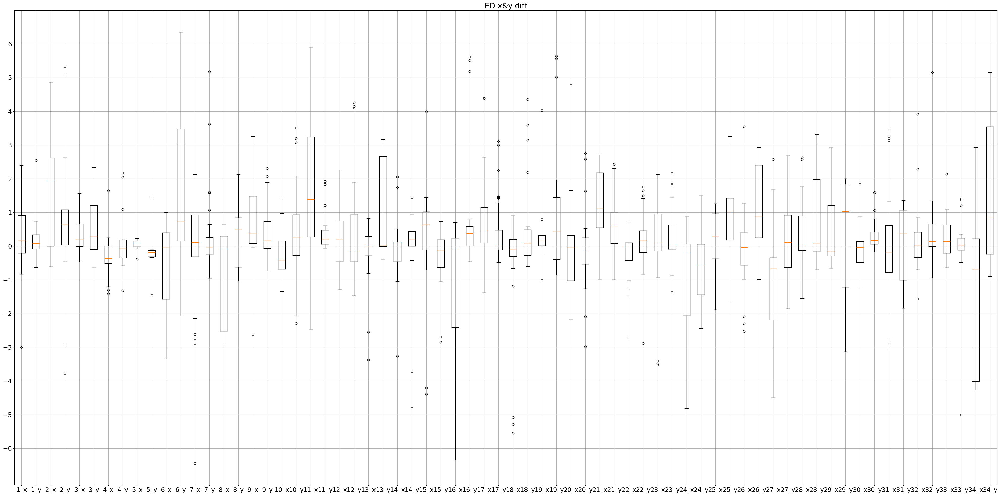

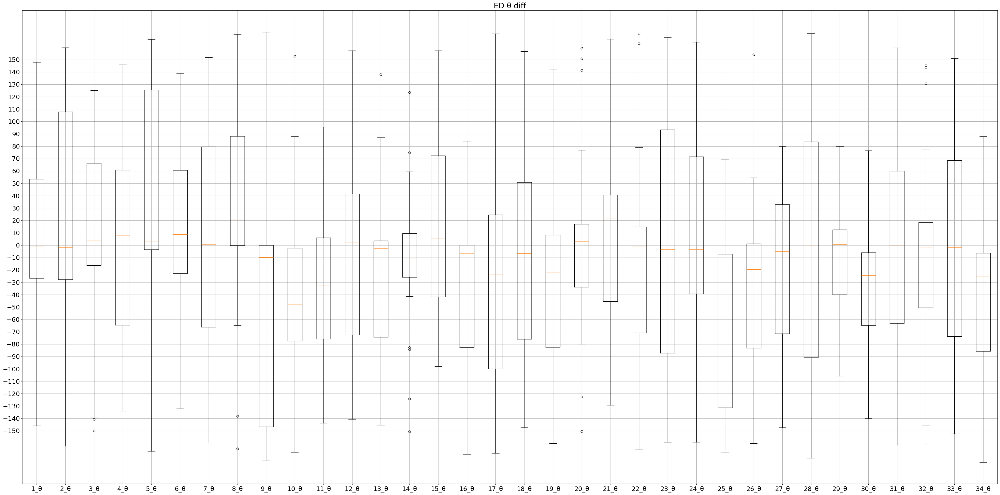

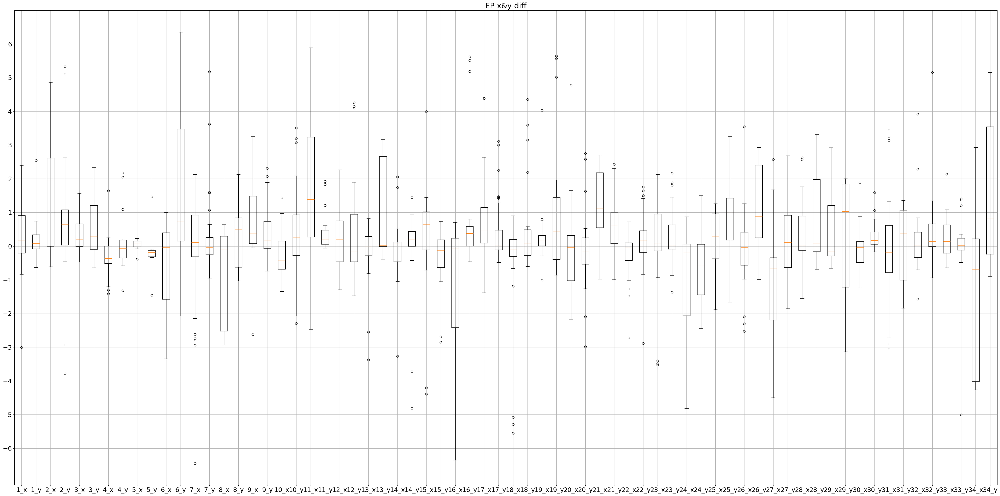

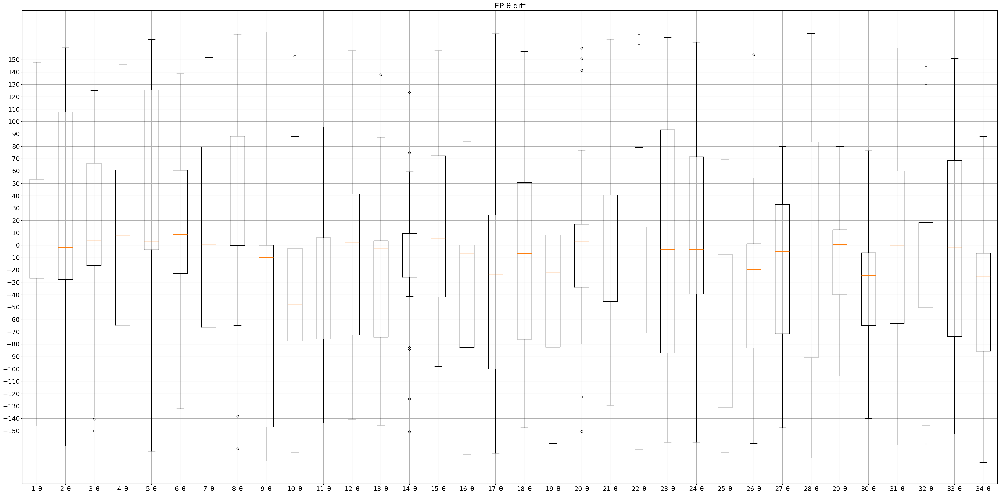

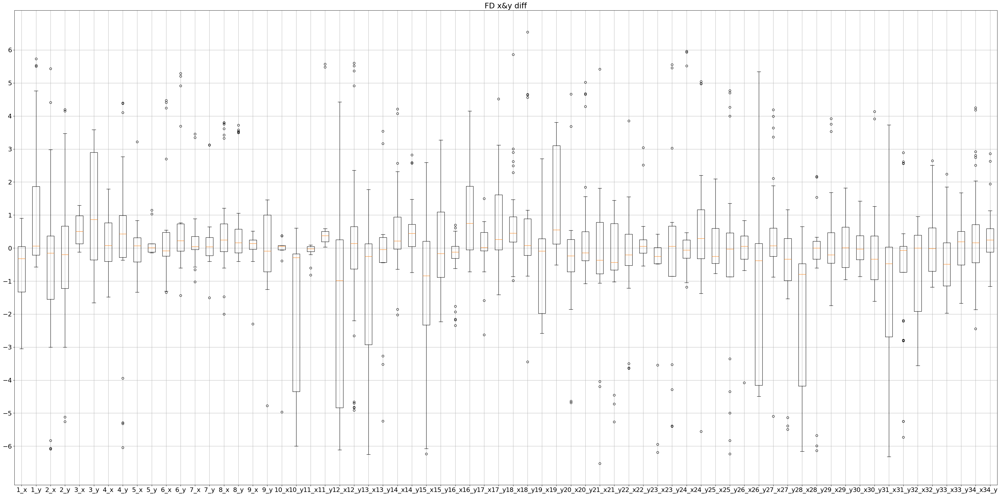

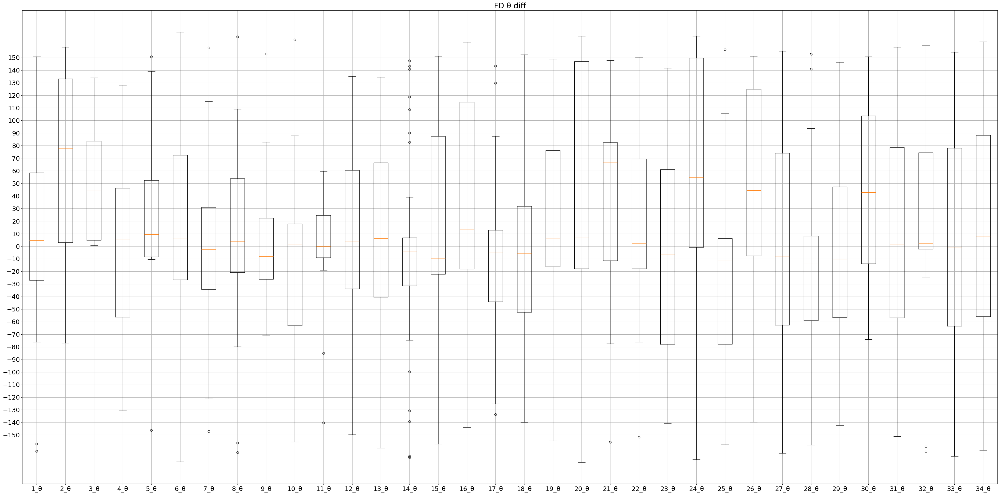

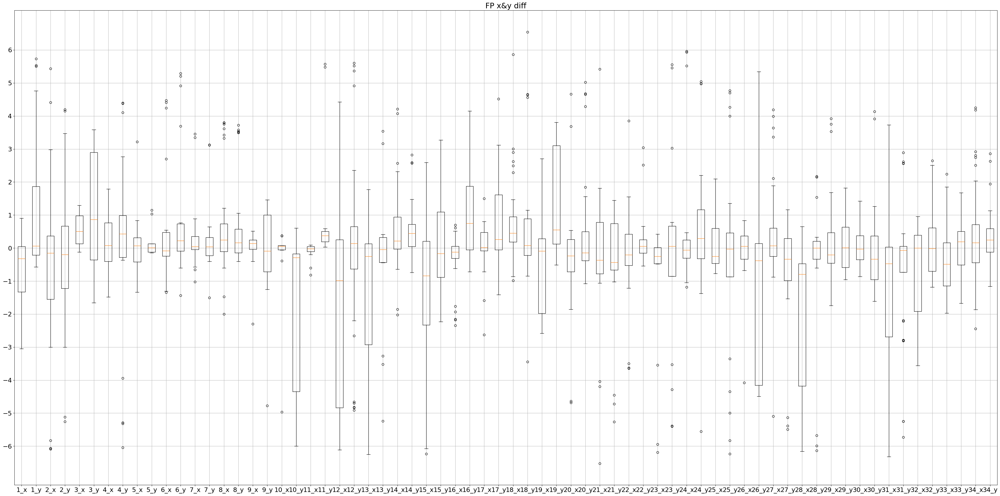

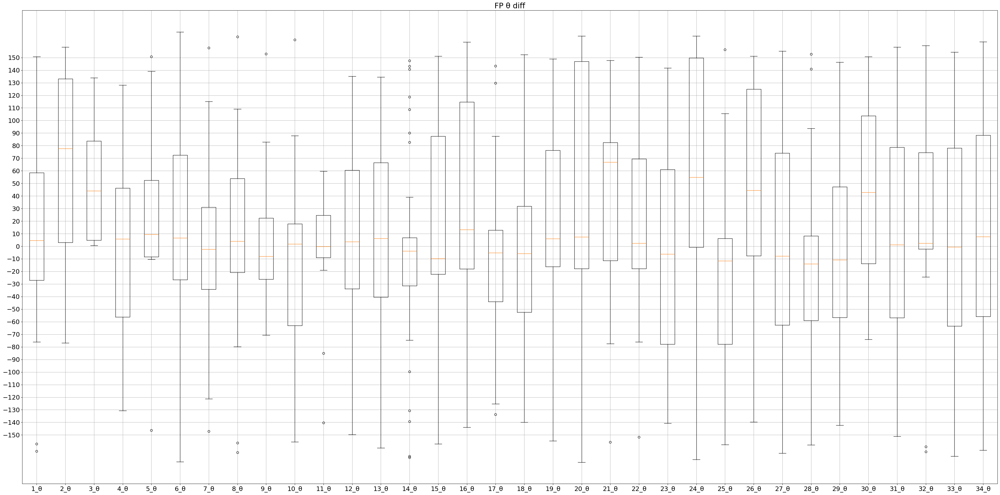

In [87]:
fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
ax.boxplot(ED_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('ED x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(ED_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('ED θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('EP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('EP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FD x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FD θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

## SVCで高確率と判断されたバイポーラ間の差分

In [ ]:
diffs = []
for list_session1 in vpolars:
    for list_session2 in vpolars:
        if list_session1['subject'] == list_session2['subject'] and list_session1['session'] == 1 and list_session2['session'] == 2 and list_session1['gesture'] == list_session2['gesture'] and list_session1['trial'] == list_session2['trial'] and list_session1['electrode_place'] == list_session2['electrode_place']:
            print(f'file_name: {list_session1["file_name"]}, gesture: {list_session1["gesture"]}, trial: {list_session1["trial"]}, subject: {list_session1["subject"]}, session: {list_session1["session"]}, electrode_place: {list_session1["electrode_place"]}')
            print(f'file_name: {list_session2["file_name"]}, gesture: {list_session2["gesture"]}, trial: {list_session2["trial"]}, subject: {list_session2["subject"]}, session: {list_session2["session"]}, electrode_place: {list_session2["electrode_place"]}')
            if list_session1['n_virtual_bipolars'] > 0 and list_session2['n_virtual_bipolars'] > 0:
                record_session1 = wfdb.rdrecord(list_session1["file_name"])
                record_session2 = wfdb.rdrecord(list_session2["file_name"])

                if list_session1['electrode_place'] == 'ED':
                    emg_data_session1 = record_session1.p_signal[:,:64] #Extensor Distal
                    emg_data_session2 = record_session2.p_signal[:,:64] #Extensor Distal
                elif list_session1['electrode_place'] == 'EP':
                    emg_data_session1 = record_session1.p_signal[:,64:128] #Extensor Proximal
                    emg_data_session2 = record_session2.p_signal[:,64:128] #Extensor Proximal
                elif list_session1['electrode_place'] == 'FD': 
                    emg_data_session1 = record_session1.p_signal[:,128:192] #Flexor Distal
                    emg_data_session2 = record_session2.p_signal[:,128:192] #Flexor Distal
                elif list_session1['electrode_place'] == 'FP':
                    emg_data_session1 = record_session1.p_signal[:,192:256] #Flexor Proximal
                    emg_data_session2 = record_session2.p_signal[:,192:256] #Flexor Proximal
                
                virtual_bipolars_session1 = list_session1['virtual_bipolars']
                virtual_bipolars_session2 = list_session2['virtual_bipolars']
                labels_session1 = list_session1['labels']
                labels_session2 = list_session2['labels']
                center_direction_session1 = list_session1['center_direction']
                center_direction_session2 = list_session2['center_direction']

                if list_session1['n_virtual_bipolars'] == 1:
                    virtual_bipolars_session1.append([0,0,0,0])
                    labels_session1.append(999)
                    center_direction_session1.append([0,0,0])
                
                virtual_emg_session1 = get_virtual_emg(emg_data_session1, virtual_bipolars_session1)
                X_session1, y_session1 = get_features(virtual_emg_session1, labels_session1)
                
                virtual_emg_session2 = get_virtual_emg(emg_data_session2, virtual_bipolars_session2)
                X_session2, y_session2 = get_features(virtual_emg_session2, labels_session2)

                result, y_train, y_test = SVC_classifier(X_session1, y_session1, X_session2, y_session2)
                diff = diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2)
            else:
                diff = [None]
            diffs.append({'file_name':[list_session1["file_name"], list_session2["file_name"]],'subject':list_session1['subject'], 'gesture':list_session1['gesture'], 'trial': list_session1['trial'], 'electrode_place':list_session1['electrode_place'], 'diff':diff})
            

In [89]:
x_ED_gesture = {}
y_ED_gesture = {}
theta_ED_gesture = {}
x_EP_gesture = {}
y_EP_gesture = {}
theta_EP_gesture = {}
x_FD_gesture = {}
y_FD_gesture = {}
theta_FD_gesture = {}
x_FP_gesture = {}
y_FP_gesture = {}
theta_FP_gesture = {}
n_gestures = 34
for i in range(n_gestures):
    x_ED_gesture[i+1] = []
    y_ED_gesture[i+1] = []
    theta_ED_gesture[i+1] = []
    x_EP_gesture[i+1] = []
    y_EP_gesture[i+1] = []
    theta_EP_gesture[i+1] = []
    x_FD_gesture[i+1] = []
    y_FD_gesture[i+1] = []
    theta_FD_gesture[i+1] = []
    x_FP_gesture[i+1] = []
    y_FP_gesture[i+1] = []
    theta_FP_gesture[i+1] = []

In [90]:
for diff_list in diffs:
    print(diff_list)
    if diff_list['diff'] != [None]:
        gesture = int(diff_list['gesture'])
        electrode_place = diff_list['electrode_place']
        if electrode_place == 'ED':
            for diff in diff_list['diff']:
                x_ED_gesture[gesture].append(diff['x_diff'])
                y_ED_gesture[gesture].append(diff['y_diff'])
                theta_ED_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'EP':
            for diff in diff_list['diff']:
                x_EP_gesture[gesture].append(diff['x_diff'])
                y_EP_gesture[gesture].append(diff['y_diff'])
                theta_EP_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'FD':
            for diff in diff_list['diff']:
                x_FD_gesture[gesture].append(diff['x_diff'])
                y_FD_gesture[gesture].append(diff['y_diff'])
                theta_FD_gesture[gesture].append(diff['theta_diff'])
        elif electrode_place == 'FP':
            for diff in diff_list['diff']:
                x_FP_gesture[gesture].append(diff['x_diff'])
                y_FP_gesture[gesture].append(diff['y_diff'])
                theta_FP_gesture[gesture].append(diff['theta_diff'])

{'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1', 'pr_dataset/subject01_session2/maintenance_preprocess_sample1'], 'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'ED', 'diff': [{'train': 0, 'test': 30, 'x_diff': 3.8259491881339103, 'y_diff': 3.593425777750928, 'theta_diff': 132.32900987559782}, {'train': 30, 'test': 10, 'x_diff': -0.02485568984674824, 'y_diff': -0.05747863767190342, 'theta_diff': 9.093665741959128}]}
{'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1', 'pr_dataset/subject01_session2/maintenance_preprocess_sample1'], 'subject': 1, 'gesture': '1', 'trial': 1, 'electrode_place': 'EP', 'diff': [{'train': 0, 'test': 21, 'x_diff': 1.7616270566401457, 'y_diff': 0.4469915498896686, 'theta_diff': -8.493755675951192}, {'train': 2, 'test': 30, 'x_diff': 3.530924984543368, 'y_diff': 3.6625367414750234, 'theta_diff': -12.84537657546042}, {'train': 30, 'test': 12, 'x_diff': -0.2999712066670277, 'y_diff': 0.35633135

In [91]:
ED_xy_list = []
EP_xy_list = []
FD_xy_list = []
FP_xy_list = []
for i in range(n_gestures):
    ED_xy_list.append(x_ED_gesture[i+1])
    ED_xy_list.append(y_ED_gesture[i+1])
    # ED_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_xy_list.append(x_EP_gesture[i+1])
    EP_xy_list.append(y_EP_gesture[i+1])
    # EP_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_xy_list.append(x_FD_gesture[i+1])
    FD_xy_list.append(y_FD_gesture[i+1])
    # FD_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_xy_list.append(x_FP_gesture[i+1])
    FP_xy_list.append(y_FP_gesture[i+1])
    # FP_list.append(theta_FP_gesture[i+1])

ED_theta_list = []
EP_theta_list = []
FD_theta_list = []
FP_theta_list = []
for i in range(n_gestures):
    ED_theta_list.append(theta_ED_gesture[i+1])
for i in range(n_gestures):
    EP_theta_list.append(theta_EP_gesture[i+1])
for i in range(n_gestures):
    FD_theta_list.append(theta_FD_gesture[i+1])
for i in range(n_gestures):
    FP_theta_list.append(theta_FP_gesture[i+1])


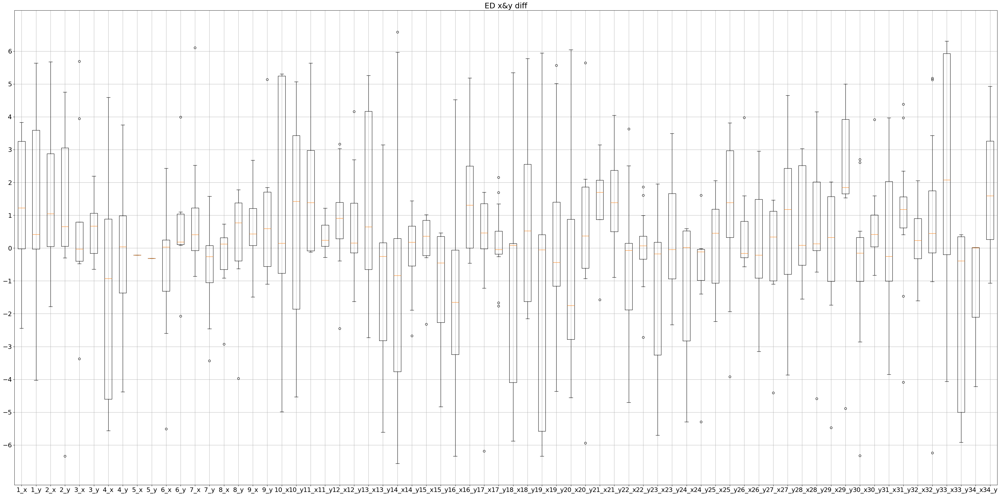

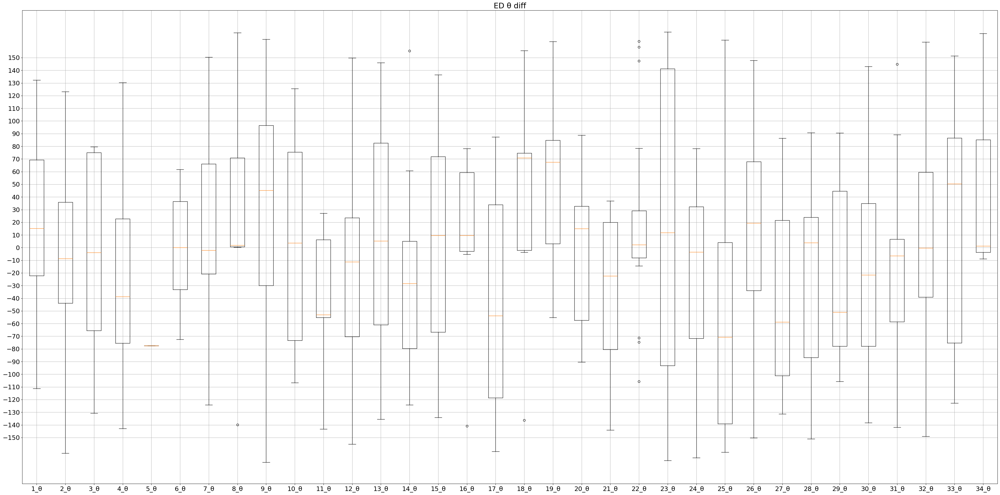

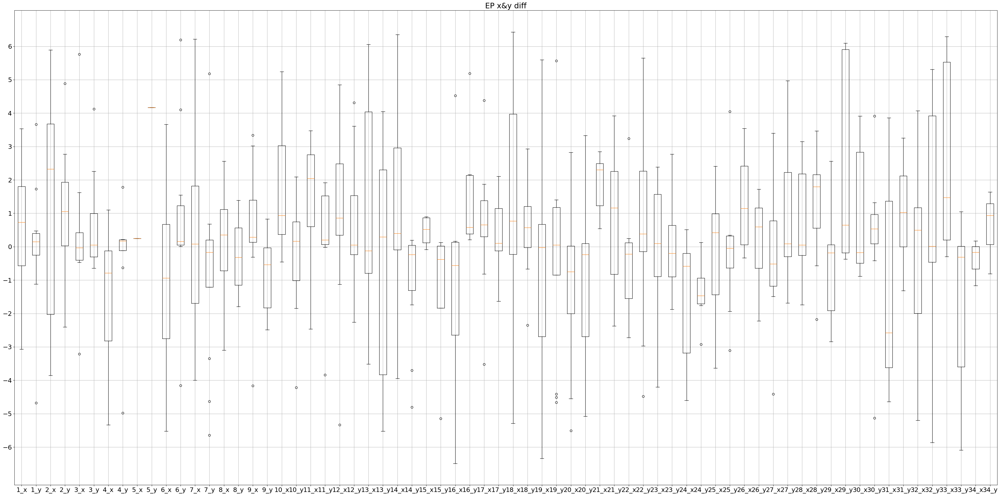

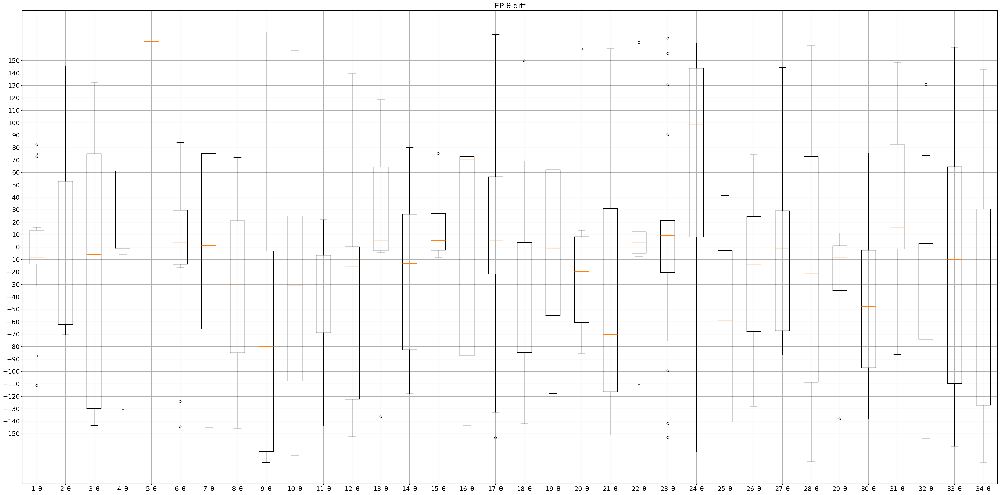

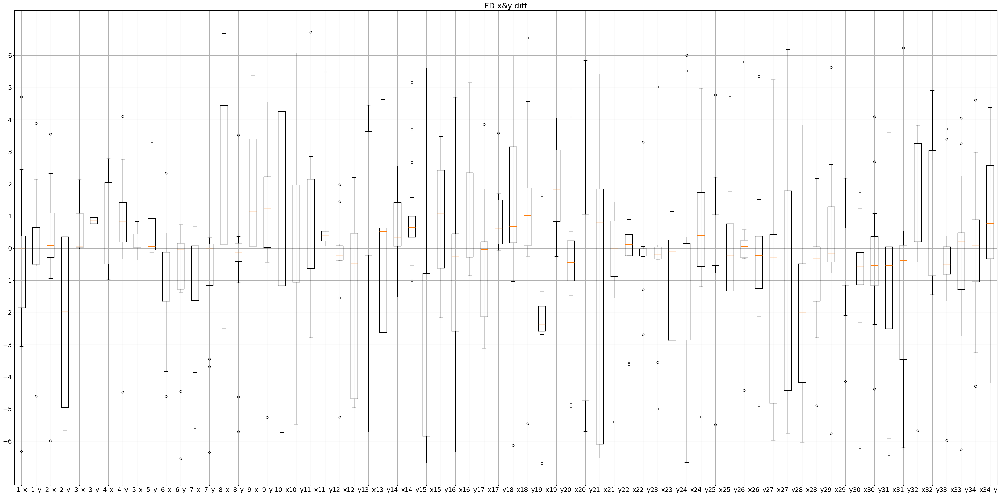

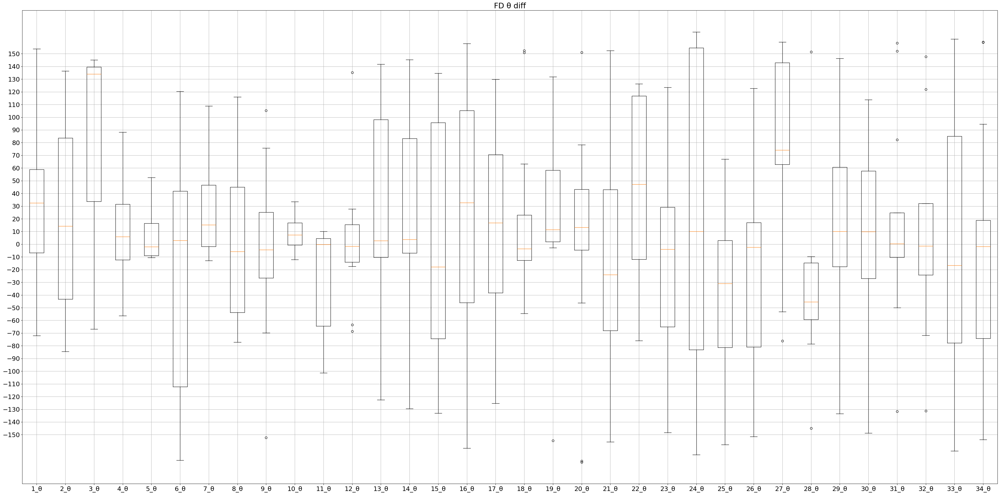

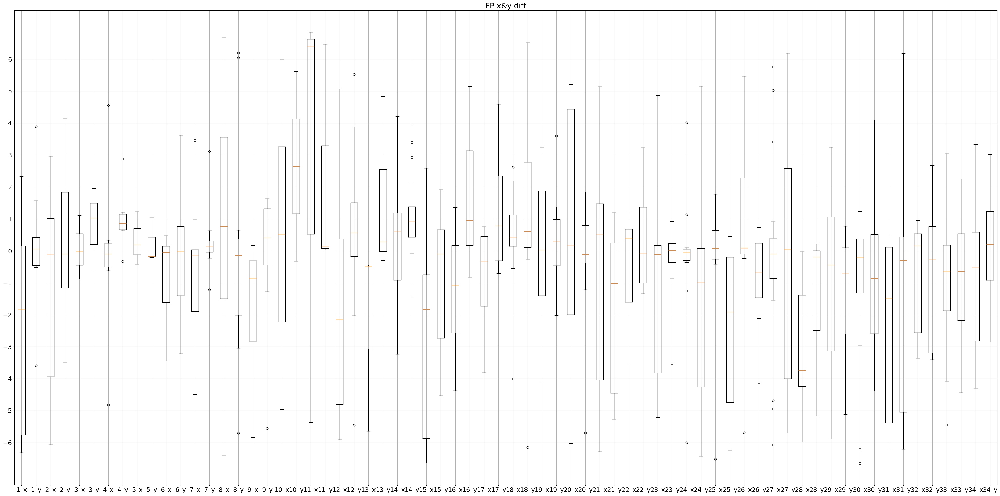

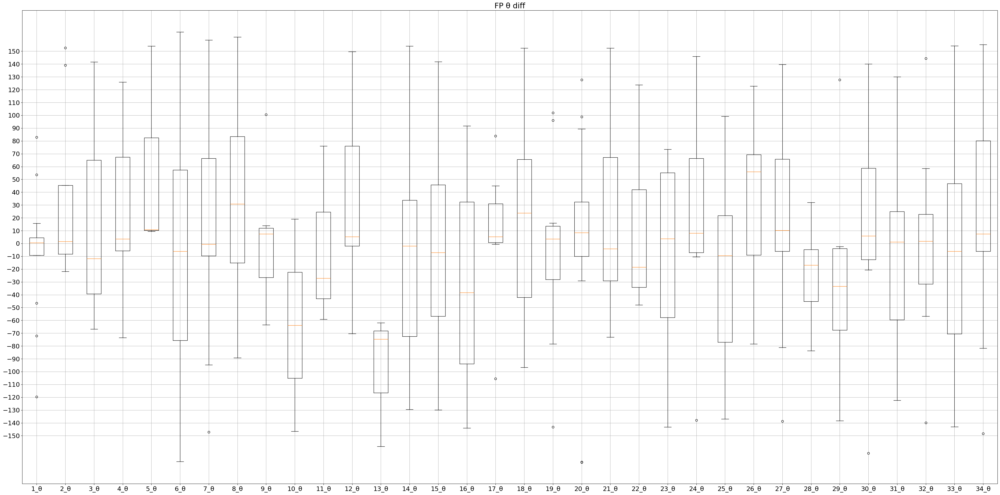

In [92]:
fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
ax.boxplot(ED_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('ED x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(ED_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('ED θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('EP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(EP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('EP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FD x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FD_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FD θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_xy_list)
ax.set_xticklabels(['1_x','1_y','2_x','2_y','3_x','3_y','4_x','4_y','5_x','5_y','6_x','6_y','7_x','7_y','8_x','8_y','9_x','9_y','10_x','10_y','11_x','11_y','12_x','12_y','13_x','13_y','14_x','14_y','15_x','15_y','16_x','16_y','17_x','17_y','18_x','18_y','19_x','19_y','20_x','20_y','21_x','21_y','22_x','22_y','23_x','23_y','24_x','24_y','25_x','25_y','26_x','26_y','27_x','27_y','28_x','28_y','29_x','29_y','30_x','30_y','31_x','31_y','32_x','32_y','33_x','33_y','34_x','34_y'])
plt.title('FP x&y diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-6, 7, 1))
plt.show()

fig, ax = plt.subplots(figsize=(40,20), tight_layout=True)
bp = ax.boxplot(FP_theta_list)
ax.set_xticklabels(['1_θ','2_θ','3_θ','4_θ','5_θ','6_θ','7_θ','8_θ','9_θ','10_θ','11_θ','12_θ','13_θ','14_θ','15_θ','16_θ','17_θ','18_θ','19_θ','20_θ','21_θ','22_θ','23_θ','24_θ','25_θ','26_θ','27_θ','28_θ','29_θ','30_θ','31_θ','32_θ','33_θ','34_θ'])
plt.title('FP θ diff')
plt.rcParams['font.size'] = 18
plt.grid()
plt.yticks(range(-150, 151, 10))
plt.show()

# テスト

In [44]:
record_session1 = wfdb.rdrecord('pr_dataset/subject01_session1/maintenance_preprocess_sample1')
record_session2 = wfdb.rdrecord('pr_dataset/subject01_session2/maintenance_preprocess_sample1')

In [45]:
filtered_emg_ED_session1 = record_session1.p_signal[:,:64] #Extensor Distal
filtered_emg_EP_session1 = record_session1.p_signal[:,64:128] #Extensor Proximal
filtered_emg_FD_session1 = record_session1.p_signal[:,128:192] #Flexor Distal
filtered_emg_FP_session1 = record_session1.p_signal[:,192:256] #Flexor Proximal

filtered_emg_ED_session2 = record_session2.p_signal[:,:64] #Extensor Distal
filtered_emg_EP_session2 = record_session2.p_signal[:,64:128] #Extensor Proximal
filtered_emg_FD_session2 = record_session2.p_signal[:,128:192] #Flexor Distal
filtered_emg_FP_session2 = record_session2.p_signal[:,192:256] #Flexor Proximal

In [46]:
i=5

検出されたピーク数（条件を満たすもの）: 638
(64,)


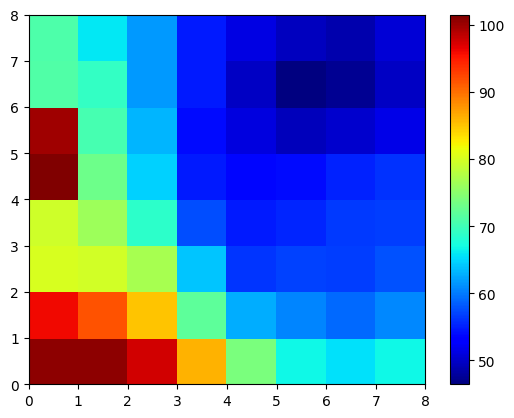

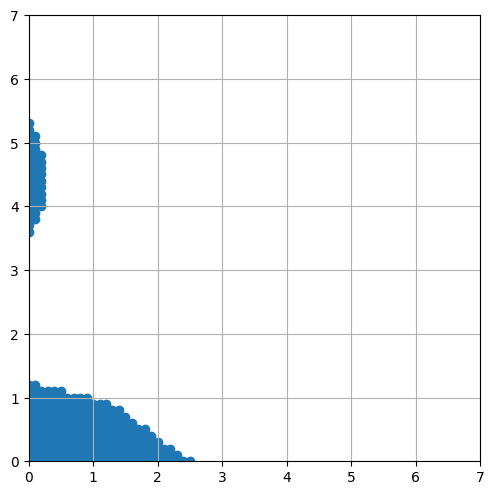

gmm_coords.shape: (253, 2)
coords_interp.shape: (2, 5041)
coords_interp: [0. 0. 0. ... 7. 7. 7.]
gmm_coords: [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  4  4
  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  4  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  5  5  5  6  6  6  6  6  6  6  6  6  6  6
  6  6  6  6  6  6  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  7  8  8
  8  8  8  8  8  8  8  8  8  8  8  8  8  9  9  9  9  9  9  9  9  9  9  9
  9  9 10 10 10 10 10 10 10 10 10 10 11 11 11 11 11 11 12 12 36 37 38 38
 39 39 40 40 40 41 41 41 42 42 42 43 43 43 44 44 44 45 45 45 46 46 46 47
 47 47 48 48 48 49 49 50 50 51 51 52 53]
map_2.shape(71, 71)


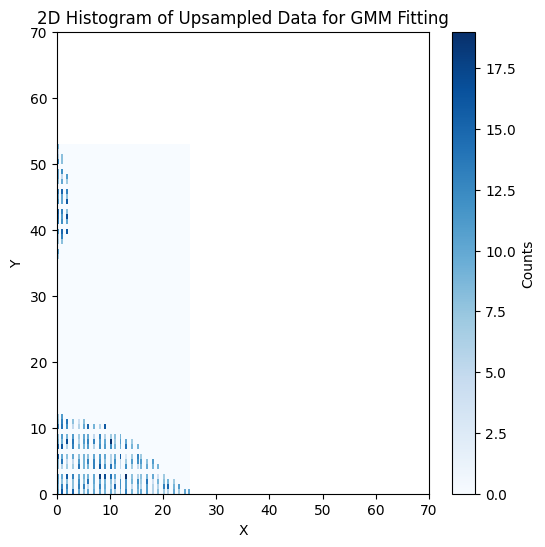

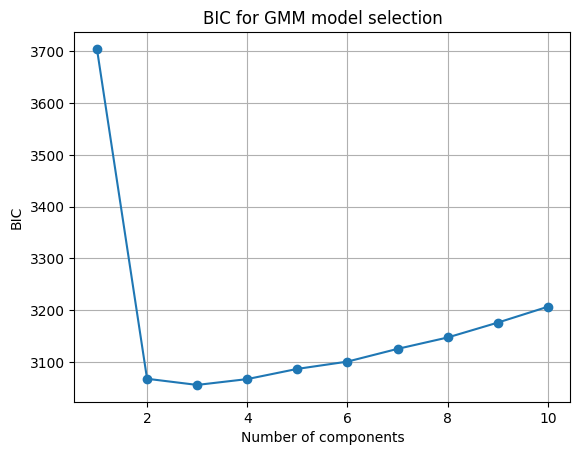

Selected n_components = 3
mean:[4.69241033 5.20178021], center:[0.46924103 0.52017802]
center: x0=0.46924103316970955, y0=0.5201780214614425, theta_1(deg)=-48.76254647752058
mean:[ 0.83027523 44.04816514], center:[0.08302752 4.40481651]
center: x0=0.0830275229357798, y0=4.404816513761448, theta_1(deg)=-89.30832730376058
mean:[14.42185885  3.49465441], center:[1.44218589 0.34946544]
center: x0=1.4421858850835434, y0=0.3494654407770932, theta_1(deg)=-22.856221784210383


C:\Users\takeu\AppData\Local\Temp\ipykernel_23968\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


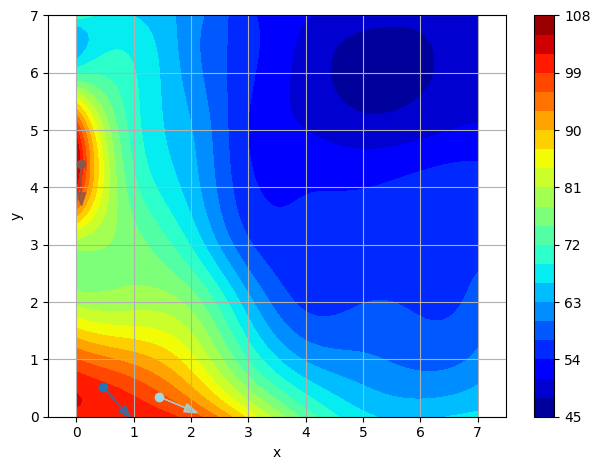

In [51]:
# def get_centers_directions(emg_data, curve, feature_func, fs=2000, window_ms=25, threshold=0):
# ---------- パラメータ設定 ----------
emg_data = filtered_emg_ED_session1  # shape: (n_samples, n_channels)
curve = gaussian_2d  # 近似曲面
feature_func = mean_frequency  # 特徴量抽出関数
fs = 2048  # サンプリング周波数
window_ms = 100    # ウィンドウ幅 [ms]
window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
threshold = 0   # featureの最大 - 平均がこの値以上なら採用
half_win = window_size // 2

# ---------- 出力先 ----------
valid_indices = []

# ---------- 64チャネルすべてに対してピーク検出 ----------
peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

for ch in range(64):
    rms_signal = np.sqrt(emg_data[:,ch]**2)
    peaks, _ = find_peaks(rms_signal, distance=50,
                      height=np.mean(rms_signal) + np.std(rms_signal))
    # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
    peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

# ---------- 全体でのピーク位置で条件を評価 ----------
for t in np.where(peak_mask)[0]:
    if t - half_win < 0 or t + half_win >= emg_data.shape[0]:
        continue  # ウィンドウが境界を超えるならスキップ

    snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
    feature_per_ch = feature_func(snippet)  # 各チャネルのfeature
    feature_mean = np.mean(feature_per_ch)
    feature_max = np.max(feature_per_ch)

    if feature_max - feature_mean >= threshold:
        valid_indices.append(t)

print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

# ----- MUAP波形の切り出し -----
snippets = []
valid_peaks = []
for peak in valid_indices:
    if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
        snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
        snippets.append(snippet)
        valid_peaks.append(peak)

snippets = np.array(snippets)
valid_peaks = np.array(valid_peaks)


# 座標グリッド
x = np.arange(8)
y = np.arange(8)
xv, yv = np.meshgrid(x, y)
coords = np.vstack((xv.ravel(), yv.ravel()))

# ==== 描画用補間座標 ====
n_interp = 10  # チャネル間の補間数（1チャネルを10分割）
x_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
y_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
x_mesh, y_mesh = np.meshgrid(x_interp, y_interp)
coords_interp = np.vstack((x_mesh.ravel(), y_mesh.ravel()))  # shape: (2, N)

centers = []
directions = []
theta_1s = []
features = []
segment = snippets[i] #何番目のピークを使うか
feature = feature_func(segment) #shape:(64,)
print(feature.shape)
map_2d = feature.reshape(8, 8)

# 補間前ヒートマップ
fig, ax = plt.subplots()
mappable = ax.pcolor(map_2d, cmap='jet')
plt.colorbar(mappable, ax=ax)
plt.show()

interp_spline = RectBivariateSpline(y, x, map_2d)
map_2d = interp_spline(y_interp, x_interp)  # shape: (Nx, Ny)

# フィッティング
# max_index = np.unravel_index(np.argmax(map_2d), map_2d.shape)
# initial = [np.max(feature)-np.min(feature), max_index[0], max_index[1], 1, 1, 0, np.min(feature)]
# bounds = ([0, 0, 0, 0.1, 0.1, -np.pi/2, -np.inf],
#         [np.inf, 7, 7, 5, 5, np.pi/2, np.inf])
# popt, _ = curve_fit(curve, coords, feature, p0=initial, bounds=bounds, maxfev=10000)
# A, x0, y0, sigma_x, sigma_y, theta, offset = popt #パラメータ取得

gmm_coords = np.column_stack(np.where(map_2d >= np.percentile(map_2d, 95)))[:,::-1]
weights = map_2d[map_2d >= np.percentile(map_2d, 95)].flatten()

# 95%以上の散布図
plt.figure(figsize=(5, 5))
plt.scatter(gmm_coords[:,0]/n_interp,gmm_coords[:,1]/n_interp)
plt.grid(True)
plt.tight_layout()
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()
print(f'gmm_coords.shape: {gmm_coords.shape}')
print(f'coords_interp.shape: {coords_interp.shape}')
print(f'coords_interp: {coords_interp[1]}')
print(f'gmm_coords: {gmm_coords[:,1]}')
print(f'map_2.shape{map_2d.shape}')


# GMMを自動選定でフィット
gmm = fit_gmm_auto(gmm_coords, max_components=10, criterion='bic', sample_weight=weights, upsample_factor=10)

arrow_scale=0.5
n_clusters = gmm.means_.shape[0]
cluster_colors = get_cluster_colors(n_clusters)
fig, ax = plt.subplots()
c = ax.contourf(x_interp, y_interp, map_2d, 20, cmap='jet')
fig.colorbar(c)
for n, (mean, cov) in enumerate(zip(gmm.means_, gmm.covariances_)):
    center = mean / n_interp  # (x, y)
    print(f'mean:{mean}, center:{center}')
    eigvals, eigvecs = np.linalg.eigh(cov)
    main_dir = eigvecs[:, np.argmax(eigvals)]
    angle = np.arctan2(main_dir[1], main_dir[0])  # 方向（ラジアン）
    angle = ninety2ninety_radian(angle)

    feature = []
    feature.append(center[0])
    feature.append(center[1])
    feature.append(np.degrees(angle))
    features.append(feature)

    x = center[0]
    y = center[1]
    dx, dy = np.cos(angle) * arrow_scale, np.sin(angle) * arrow_scale #
    print(f'center: x0={x}, y0={y}, theta_1(deg)={np.degrees(angle)}')
    color = cluster_colors[n]
    ax.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
    ax.plot(x, y, 'o', color=color)
    # plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
    # plt.plot(x, y, 'o', color=color)


plt.xlabel("x")
plt.ylabel("y")
# plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
# plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()



# for snippet in snippets[:]:
#   segment = snippet
#   #ピーク間振幅
#   feature = feature_func(segment, fs=fs) #shape:(64,)
#   map_2d = feature.reshape(8, 8)

#   # フィッティング
#   max_index = np.unravel_index(np.argmax(map_2d), map_2d.shape)
#   initial = [np.max(feature)-np.min(feature), max_index[0], max_index[1], 1, 1, 0, np.min(feature)]
#   bounds = ([0, 0, 0, 0.1, 0.1, -np.pi/2, -np.inf],
#           [np.inf, 7, 7, 5, 5, np.pi/2, np.inf])
#   popt, _ = curve_fit(curve, coords, feature, p0=initial, bounds=bounds, maxfev=10000)
#   A, x0, y0, sigma_x, sigma_y, theta, offset = popt #パラメータ取得
#   center = (x0, y0)
#   if sigma_x > sigma_y:
#     theta_1 = ninety2ninety_radian(theta)
#     # print('σx > σy')
#   else:
#     theta_1 = ninety2ninety_radian(theta + np.pi/2)
#     # print('σy >= σx')
#   direction = (np.cos(theta_1), np.sin(theta_1))

#   centers.append(center)
#   directions.append(direction)
#   theta_1s.append(np.degrees(theta_1))

#   feature = []
#   feature.append(center[0])
#   feature.append(center[1])
#   feature.append(np.degrees(theta_1))
#   features.append(feature)

# print(centers)
# print(directions)
# print(theta_1s)
# print(f'all centers:: ave:{np.mean(centers, axis=0)}, std:{np.std(centers, axis=0)}')
# print(f'all theta_1:: ave:{np.mean(theta_1s, axis=0)}, std:{np.std(theta_1s, axis=0)}')

  # return features

検出されたピーク数（条件を満たすもの）: 649


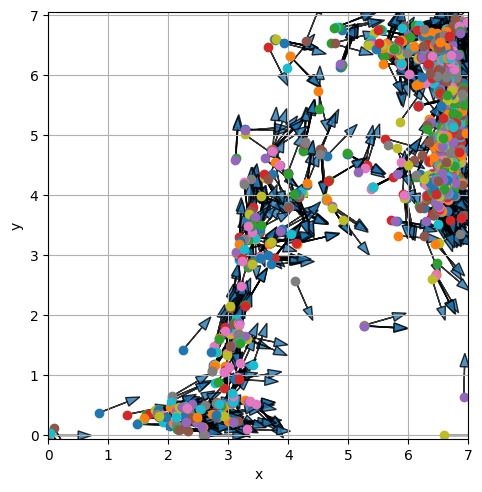

In [39]:
# def get_centers_directions(emg_data, curve, feature_func, fs=2000, window_ms=25, threshold=0, percent=95, max_components=10, criterion='bic', upsample_factor=10):
# ---------- パラメータ設定 ----------
emg_data = filtered_emg_ED_session2  # shape: (n_samples, n_channels)
curve = gaussian_2d  # 近似曲面
feature_func = ptp  # 特徴量抽出関数
fs = 2048  # サンプリング周波数
window_ms = 25    # ウィンドウ幅 [ms]
window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
threshold = 0   # featureの最大 - 平均がこの値以上なら採用
half_win = window_size // 2
percent=95
max_components=4
criterion='bic'
upsample_factor=10

# ---------- 出力先 ----------
valid_indices = []

# ---------- 64チャネルすべてに対してピーク検出 ----------
peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

for ch in range(64):
    rms_signal = np.sqrt(emg_data[:,ch]**2)
    peaks, _ = find_peaks(rms_signal, distance=50,
                    height=np.mean(rms_signal) + np.std(rms_signal))
    # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
    peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

# ---------- 全体でのピーク位置で条件を評価 ----------
for t in np.where(peak_mask)[0]:
    if t - half_win < 0 or t + half_win >= emg_data.shape[0]:
        continue  # ウィンドウが境界を超えるならスキップ

    snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
    feature_per_ch = feature_func(snippet)  # 各チャネルのfeature
    feature_mean = np.mean(feature_per_ch)
    feature_max = np.max(feature_per_ch)

    if feature_max - feature_mean >= threshold:
        valid_indices.append(t)

print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

# ----- MUAP波形の切り出し -----
snippets = []
valid_peaks = []
for peak in valid_indices:
    if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
        snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
        snippets.append(snippet)
        valid_peaks.append(peak)

snippets = np.array(snippets)
valid_peaks = np.array(valid_peaks)


plt.figure(figsize=(5, 5))

centers = []
directions = []
theta_1s = []
features = []
for snippet in snippets[:]:
    segment = snippet
    feature = feature_func(segment) #shape:(64,)
    map_2d = feature.reshape(8, 8)
    
    # 座標グリッド
    x = np.arange(8)
    y = np.arange(8)
    xv, yv = np.meshgrid(x, y)
    coords = np.vstack((xv.ravel(), yv.ravel()))

    # ==== 描画用補間座標 ====
    n_interp = 10  # チャネル間の補間数（1チャネルを10分割）
    x_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
    y_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
    x_mesh, y_mesh = np.meshgrid(x_interp, y_interp)
    coords_interp = np.vstack((x_mesh.ravel(), y_mesh.ravel()))  # shape: (2, N)

    # # 補間前ヒートマップ
    # fig, ax = plt.subplots()
    # mappable = ax.pcolor(map_2d, cmap='jet')
    # plt.colorbar(mappable, ax=ax)
    # plt.show()

    interp_spline = RectBivariateSpline(y, x, map_2d)
    map_2d = interp_spline(y_interp, x_interp)  # shape: (Nx, Ny)

    percent = percent
    gmm_coords = np.column_stack(np.where(map_2d >= np.percentile(map_2d, percent)))[:,::-1]
    weights = map_2d[map_2d >= np.percentile(map_2d, percent)].flatten()

    # GMMを自動選定でフィット
    gmm = fit_gmm_auto(gmm_coords, max_components=max_components, criterion=criterion, sample_weight=weights, upsample_factor=upsample_factor, map_visualize=False, criterion_visualize=False)

    arrow_scale=0.5
    # n_clusters = gmm.means_.shape[0]
    # cluster_colors = get_cluster_colors(n_clusters)
    for n, (mean, cov) in enumerate(zip(gmm.means_, gmm.covariances_)):
        center = mean / n_interp  # (x, y)
        # print(f'mean:{mean}, center:{center}')
        eigvals, eigvecs = np.linalg.eigh(cov)
        main_dir = eigvecs[:, np.argmax(eigvals)]
        angle = np.arctan2(main_dir[1], main_dir[0])  # 方向（ラジアン）
        angle = ninety2ninety_radian(angle)

        feature = []
        feature.append(center[0])
        feature.append(center[1])
        feature.append(np.degrees(angle))
        features.append(feature)

        x = center[0]
        y = center[1]
        dx, dy = np.cos(angle) * arrow_scale, np.sin(angle) * arrow_scale #
        # print(f'center: x0={x}, y0={y}, theta_1(deg)={np.degrees(angle)}')
        # color = cluster_colors[n]
        plt.arrow(x, y, dx, dy, head_width=0.15, alpha=0.8)
        plt.plot(x, y, 'o')


plt.xlabel("x")
plt.ylabel("y")
plt.grid(True)
plt.axis('equal')
plt.tight_layout()
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()

    # return features

検出されたピーク数（条件を満たすもの）: 912
center: x0=2.800278542467664, y0=2.3421503114962596, theta_1(deg)=71.46580449532132


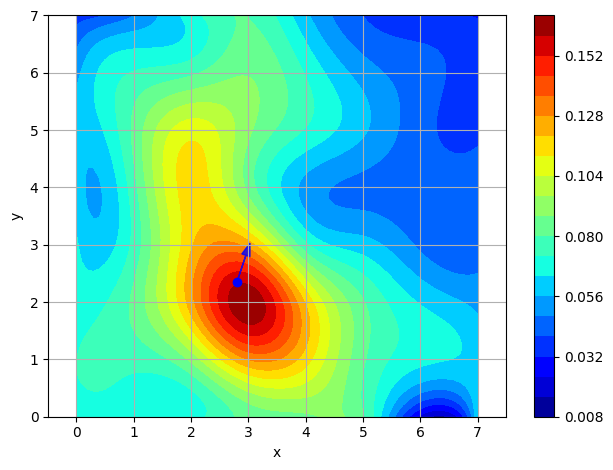

In [181]:
# def get_centers_directions(emg_data, curve, feature_func, fs=2000, window_ms=25, threshold=0):
# ---------- パラメータ設定 ----------
emg_data = filtered_emg_FD_session1  # shape: (n_samples, n_channels)
curve = gaussian_2d  # 近似曲面
feature_func = ptp  # 特徴量抽出関数
fs = 2048  # サンプリング周波数
window_ms = 25    # ウィンドウ幅 [ms]
window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
threshold = 0   # featureの最大 - 平均がこの値以上なら採用
half_win = window_size // 2


# ---------- 出力先 ----------
valid_indices = []

# ---------- 64チャネルすべてに対してピーク検出 ----------
peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

for ch in range(64):
    rms_signal = np.sqrt(emg_data[:,ch]**2)
    peaks, _ = find_peaks(rms_signal, distance=50,
                      height=np.mean(rms_signal) + np.std(rms_signal))
    # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
    peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

# ---------- 全体でのピーク位置で条件を評価 ----------
for t in np.where(peak_mask)[0]:
    if t - half_win < 0 or t + half_win >= emg_data.shape[0]:
        continue  # ウィンドウが境界を超えるならスキップ

    snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
    feature_per_ch = feature_func(snippet)  # 各チャネルのfeature
    feature_mean = np.mean(feature_per_ch)
    feature_max = np.max(feature_per_ch)

    if feature_max - feature_mean >= threshold:
        valid_indices.append(t)

print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

# ----- MUAP波形の切り出し -----
snippets = []
valid_peaks = []
for peak in valid_indices:
    if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
        snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
        snippets.append(snippet)
        valid_peaks.append(peak)

snippets = np.array(snippets)
valid_peaks = np.array(valid_peaks)


# 座標グリッド
x = np.arange(8)
y = np.arange(8)
xv, yv = np.meshgrid(x, y)
coords = np.vstack((xv.ravel(), yv.ravel()))

# ==== 描画用補間座標 ====
n_interp = 10  # チャネル間の補間数（1チャネルを10分割）
x_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
y_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
x_mesh, y_mesh = np.meshgrid(x_interp, y_interp)
coords_interp = np.vstack((x_mesh.ravel(), y_mesh.ravel()))  # shape: (2, N)


segment = snippets[i] #何番目のピークを使うか
feature = feature_func(segment) #shape:(64,)
map_2d = feature.reshape(8, 8)

interp_spline = RectBivariateSpline(y, x, map_2d)
map_2d_interp = interp_spline(y_interp, x_interp)  # shape: (Nx, Ny)
# map_2d = interp_spline(y_interp, x_interp) # ガウシアンフィッティングにも補間座標を適用

# フィッティング
max_index = np.unravel_index(np.argmax(map_2d), map_2d.shape)
initial = [np.max(feature)-np.min(feature), max_index[0], max_index[1], 1, 1, 0, np.min(feature)]
bounds = ([0, 0, 0, 0.1, 0.1, -np.pi/2, -np.inf],
        [np.inf, 7, 7, 5, 5, np.pi/2, np.inf])
popt, _ = curve_fit(curve, coords, feature, p0=initial, bounds=bounds, maxfev=10000)
A, x0, y0, sigma_x, sigma_y, theta, offset = popt #パラメータ取得
center = (x0, y0)
if sigma_x > sigma_y:
  theta_1 = ninety2ninety_radian(theta)
  # print('σx > σy')
else:
  theta_1 = ninety2ninety_radian(theta + np.pi/2)
  # print('σy >= σx')
direction = (np.cos(theta_1), np.sin(theta_1))

arrow_scale=0.5
fig, ax = plt.subplots()
c = ax.contourf(x_interp, y_interp, map_2d_interp, 20, cmap='jet')
fig.colorbar(c)

x = x0
y = y0
dx, dy = np.cos(theta_1) * arrow_scale, np.sin(theta_1) * arrow_scale #
print(f'center: x0={x}, y0={y}, theta_1(deg)={np.degrees(theta_1)}')
ax.arrow(x, y, dx, dy, head_width=0.15, color='blue',alpha=0.8)
ax.plot(x, y, 'o', color='blue')

plt.xlabel("x")
plt.ylabel("y")
# plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
# plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()

検出されたピーク数（条件を満たすもの）: 912
Max spline index: (23, 30)
spline_map shape: (71, 71)
initial coords: x=2.3, y=3.0
coords_interp.shape=(2, 5041), z_spline.shape=(5041,), spline_map.shape=(71, 71)
center: x0=2.996601054129019, y0=2.453203874397326, theta_1(deg)=-89.88321145189538


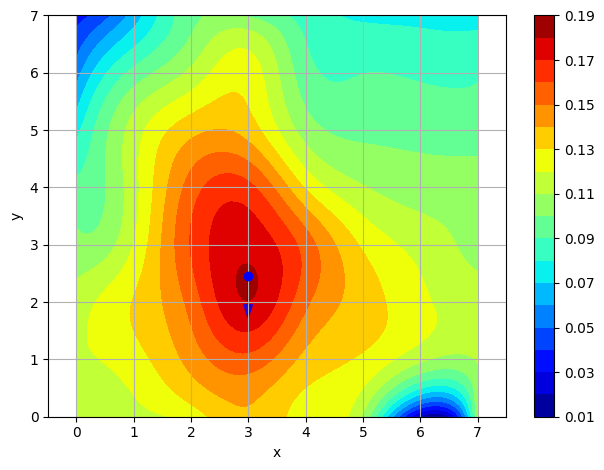

In [147]:
# def get_centers_directions(emg_data, curve, feature_func, fs=2000, window_ms=25, threshold=0):
# ---------- パラメータ設定 ----------
emg_data = filtered_emg_FD_session1  # shape: (n_samples, n_channels)
curve = gaussian_2d  # 近似曲面
feature_func = ptp  # 特徴量抽出関数
fs = 2048  # サンプリング周波数
window_ms = 25    # ウィンドウ幅 [ms]
window_size = int(fs * (window_ms / 1000))  # サンプル数に変換
threshold = 0   # featureの最大 - 平均がこの値以上なら採用
half_win = window_size // 2


# ---------- 出力先 ----------
valid_indices = []

# ---------- 64チャネルすべてに対してピーク検出 ----------
peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

for ch in range(64):
    rms_signal = np.sqrt(emg_data[:,ch]**2)
    peaks, _ = find_peaks(rms_signal, distance=50,
                      height=np.mean(rms_signal) + np.std(rms_signal))
    # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
    peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

# ---------- 全体でのピーク位置で条件を評価 ----------
for t in np.where(peak_mask)[0]:
    if t - half_win < 0 or t + half_win >= emg_data.shape[0]:
        continue  # ウィンドウが境界を超えるならスキップ

    snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
    feature_per_ch = feature_func(snippet)  # 各チャネルのfeature
    feature_mean = np.mean(feature_per_ch)
    feature_max = np.max(feature_per_ch)

    if feature_max - feature_mean >= threshold:
        valid_indices.append(t)

print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

# ----- MUAP波形の切り出し -----
snippets = []
valid_peaks = []
for peak in valid_indices:
    if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
        snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
        snippets.append(snippet)
        valid_peaks.append(peak)

snippets = np.array(snippets)
valid_peaks = np.array(valid_peaks)


# 座標グリッド
x = np.arange(8)
y = np.arange(8)
xv, yv = np.meshgrid(x, y)
coords = np.vstack((xv.ravel(), yv.ravel()))

# ==== 描画用補間座標 ====
n_interp = 10  # チャネル間の補間数（1チャネルを10分割）
x_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
y_interp = np.linspace(0, 7, (8 - 1) * n_interp + 1)
x_mesh, y_mesh = np.meshgrid(x_interp, y_interp)
coords_interp = np.vstack((x_mesh.ravel(), y_mesh.ravel()))  # shape: (2, N)


segment = snippets[i] #何番目のピークを使うか
feature = feature_func(segment) #shape:(64,)
map_2d = feature.reshape(8, 8)

interp_spline = RectBivariateSpline(y, x, map_2d)
map_2d_interp = interp_spline(y_interp, x_interp)  # shape: (Nx, Ny)
spline_map = interp_spline(y_interp, x_interp) # ガウシアンフィッティングにも補間座標を適用
z_spline = spline_map.ravel()

# フィッティング
max_spline_index = np.unravel_index(np.argmax(spline_map), spline_map.shape)
initial_x = max_spline_index[0]/n_interp
initial_y = max_spline_index[1]/n_interp
print(f"Max spline index: {max_spline_index}")
print(f'spline_map shape: {spline_map.shape}')
print(f'initial coords: x={initial_x}, y={initial_y}')
print(f'coords_interp.shape={coords_interp.shape}, z_spline.shape={z_spline.shape}, spline_map.shape={spline_map.shape}')
initial = [np.max(z_spline)-np.min(z_spline), initial_x, initial_y, 1, 1, 0, np.min(z_spline)]
bounds = ([0, 0, 0, 0.1, 0.1, -np.pi/2, -np.inf],
          [np.inf, 7, 7, 5, 5, np.pi/2, np.inf])
popt, _ = curve_fit(curve, coords_interp, z_spline, p0=initial, bounds=bounds, maxfev=10000)
A, x0, y0, sigma_x, sigma_y, theta, offset = popt #パラメータ取得
center = (x0, y0)
if sigma_x > sigma_y:
  theta_1 = ninety2ninety_radian(theta)
  # print('σx > σy')
else:
  theta_1 = ninety2ninety_radian(theta + np.pi/2)
  # print('σy >= σx')
direction = (np.cos(theta_1), np.sin(theta_1))

arrow_scale=0.5
fig, ax = plt.subplots()
c = ax.contourf(x_interp, y_interp, map_2d_interp, 20, cmap='jet')
fig.colorbar(c)

x = x0
y = y0
dx, dy = np.cos(theta_1) * arrow_scale, np.sin(theta_1) * arrow_scale #
print(f'center: x0={x}, y0={y}, theta_1(deg)={np.degrees(theta_1)}')
ax.arrow(x, y, dx, dy, head_width=0.15, color='blue',alpha=0.8)
ax.plot(x, y, 'o', color='blue')

plt.xlabel("x")
plt.ylabel("y")
# plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
# plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xticks(np.arange(0, 8, 1))
plt.yticks(np.arange(0, 8, 1))
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()

検出されたピーク数（条件を満たすもの）: 912


C:\Users\takeu\AppData\Local\Temp\ipykernel_23968\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


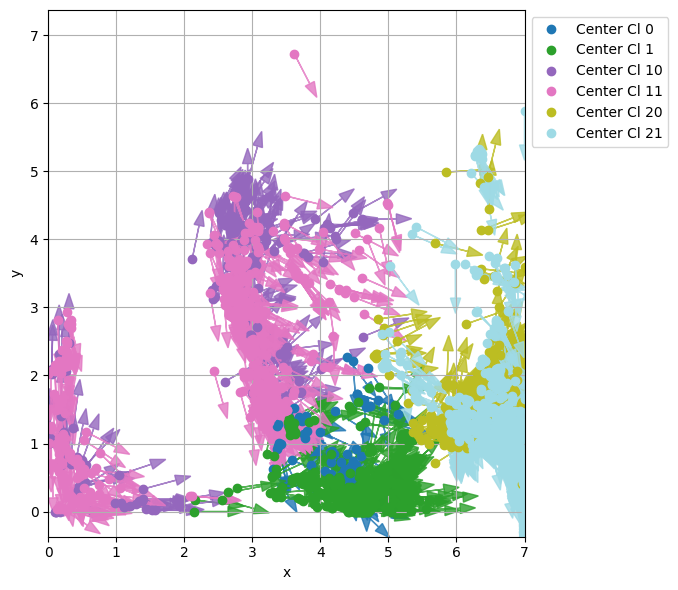

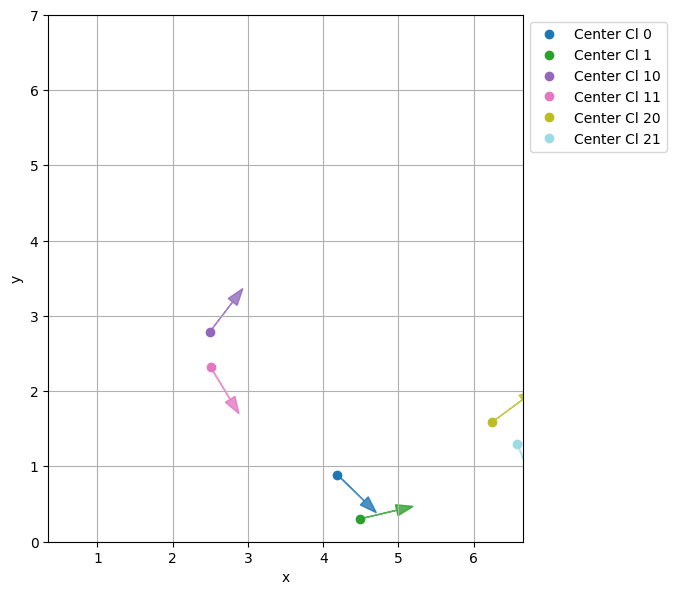

In [59]:
emg_data_session1 = filtered_emg_FD_session1
features_session1 = get_centers_directions(emg_data_session1,gaussian_2d, rms, 2000,25)
results_df_session1, summary_df_session1 = clustering(features_session1, k1=3, k2=2)
summary_df_session1
plot_fiber(results_df_session1)
virtual_bipolars_session1, labels_session1, center_direction_session1, n_virtual_bipolars_session1 = get_virtual_bipolars(results_df_session1)
virtual_emg_session1 = get_virtual_emg(emg_data_session1, virtual_bipolars_session1)
X_session1, y_session1 = get_features(virtual_emg_session1, labels_session1)

検出されたピーク数（条件を満たすもの）: 609


C:\Users\takeu\AppData\Local\Temp\ipykernel_23968\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


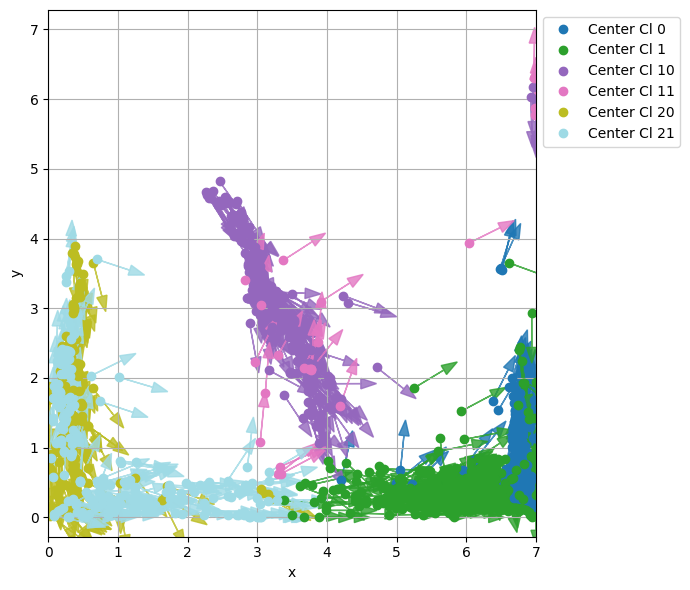

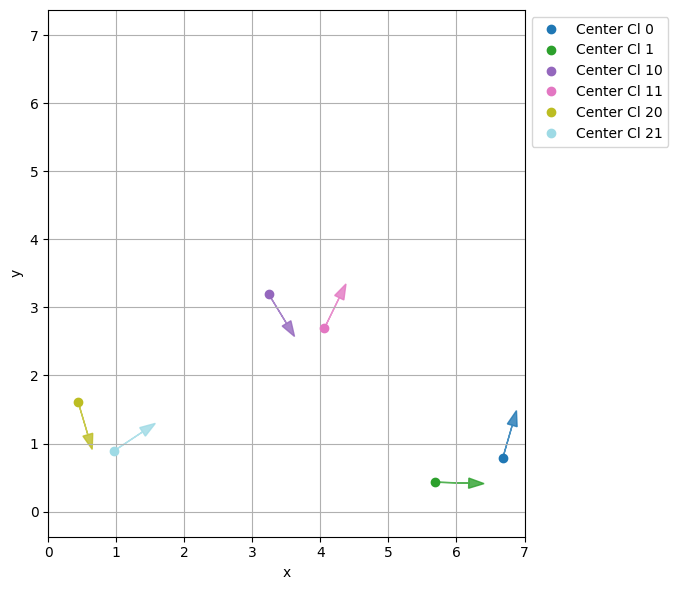

In [60]:
emg_data_session2 = filtered_emg_FD_session2
features_session2 = get_centers_directions(emg_data_session2,gaussian_2d, rms, 2000,25)
results_df_session2, summary_df_session2 = clustering(features_session2, k1=3, k2=2)
summary_df_session2
plot_fiber(results_df_session2)
virtual_bipolars_session2, labels_session2, center_direction_session2, n_virtual_bipolars_session2 = get_virtual_bipolars(results_df_session2)
virtual_emg_session2 = get_virtual_emg(emg_data_session2, virtual_bipolars_session2)
X_session2, y_session2 = get_features(virtual_emg_session2, labels_session2)

In [159]:
summary_df_session1

,cluster,center_x_mean,center_x_std,center_y_mean,center_y_std,theta_deg_mean,theta_deg_std,count
0,0,2.422315,0.868646,4.354374,1.387342,-8.942075,56.787375,40
1,1,2.449972,0.722740,4.184903,1.175345,-15.458593,83.187139,66
2,2,2.749097,0.937527,4.929814,1.445651,-5.455918,26.997644,48
3,10,5.701628,1.495503,0.686238,0.629430,-31.056992,50.362074,37
4,11,4.643135,1.633042,1.016923,0.688866,-33.522504,76.277764,33
5,12,5.013609,1.739702,0.678575,0.573127,-2.333905,16.904220,71
6,20,6.512788,0.597538,3.501018,0.249069,-10.720938,19.705314,30
7,21,5.335410,0.586528,3.609914,0.421116,-5.005314,68.166472,11
8,22,6.635289,0.416817,3.449483,1.035760,29.476661,80.955168,21
9,30,6.256506,0.615164,6.393637,0.720747,-18.921101,73.968812,23


In [160]:
summary_df_session2

,cluster,center_x_mean,center_x_std,center_y_mean,center_y_std,theta_deg_mean,theta_deg_std,count
0,0,6.019974,0.886804,1.986531,1.116491,-1.226718,22.855913,122
1,1,5.822146,0.749288,2.311047,1.113573,-31.287455,77.673721,42
2,2,6.268530,0.579236,2.044770,1.447048,-0.285111,55.541435,28
3,10,1.788458,0.532265,4.802297,1.061695,16.032749,65.968380,43
4,11,2.397312,0.555297,5.272397,0.926989,-7.157849,27.543675,61
5,12,2.107264,0.583359,4.739549,0.766643,26.620240,83.316075,66
6,20,2.543424,0.913659,1.408311,0.680241,-15.145749,43.456027,28
7,21,2.051515,0.844561,1.541666,1.151428,-1.484318,86.506016,23
8,22,2.526606,0.899992,1.013429,0.995929,-1.903584,13.235124,68
9,30,4.497429,0.924421,6.678763,0.531231,-0.712612,19.402383,49


In [174]:
filtered_emg_ED_session1.shape

(8192, 64)

検出されたピーク数（条件を満たすもの）: 317


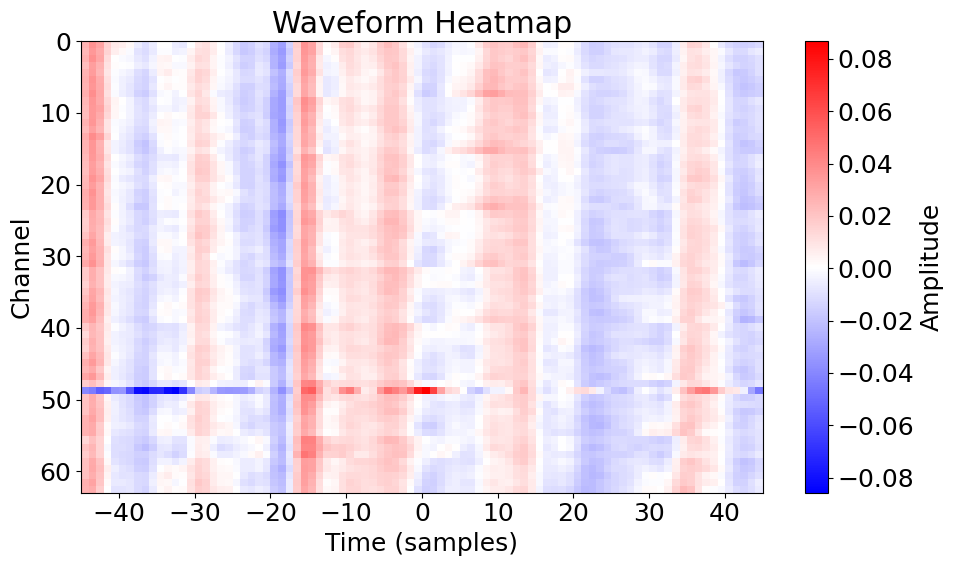

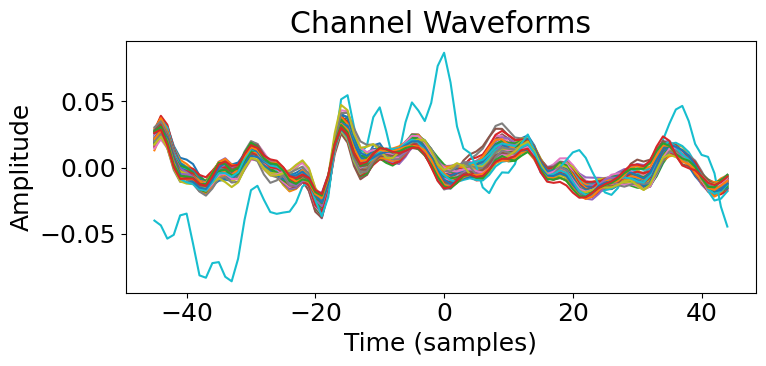

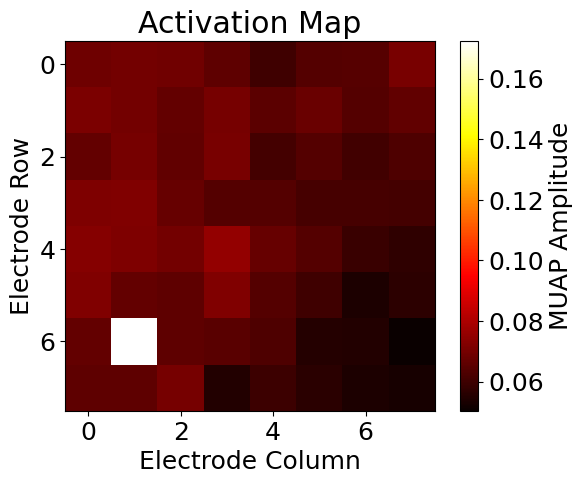

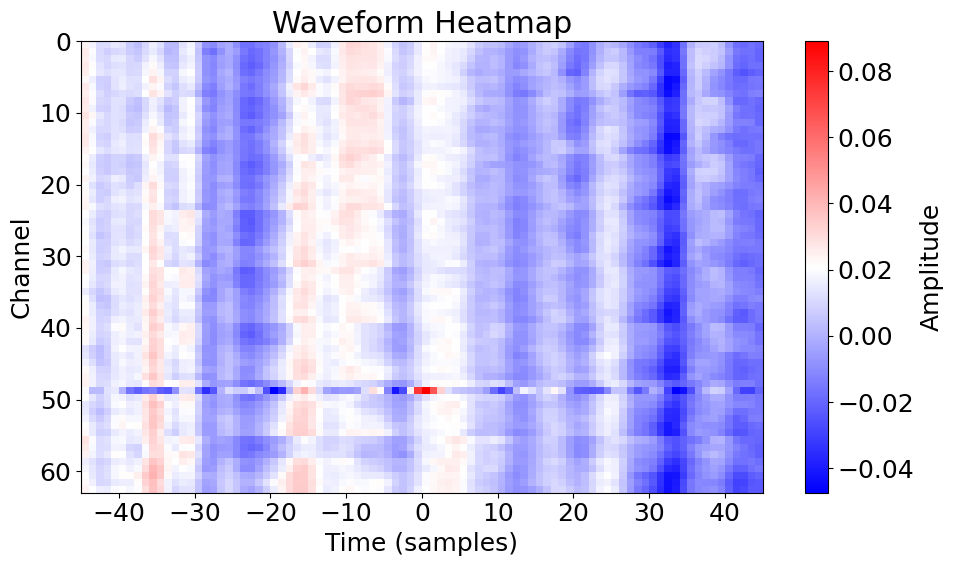

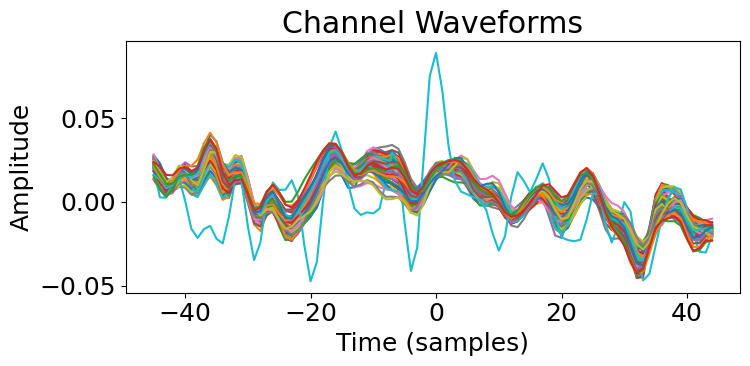

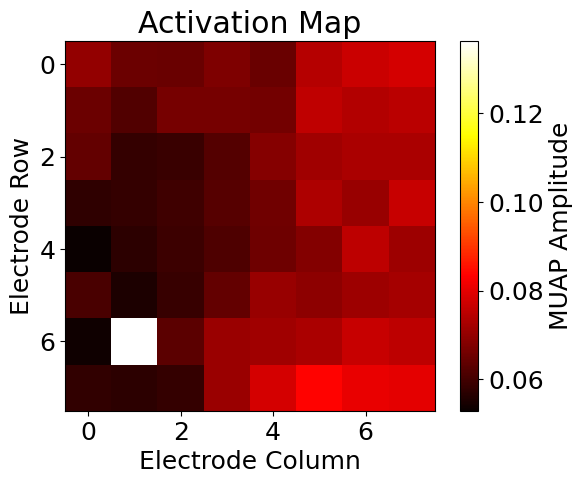

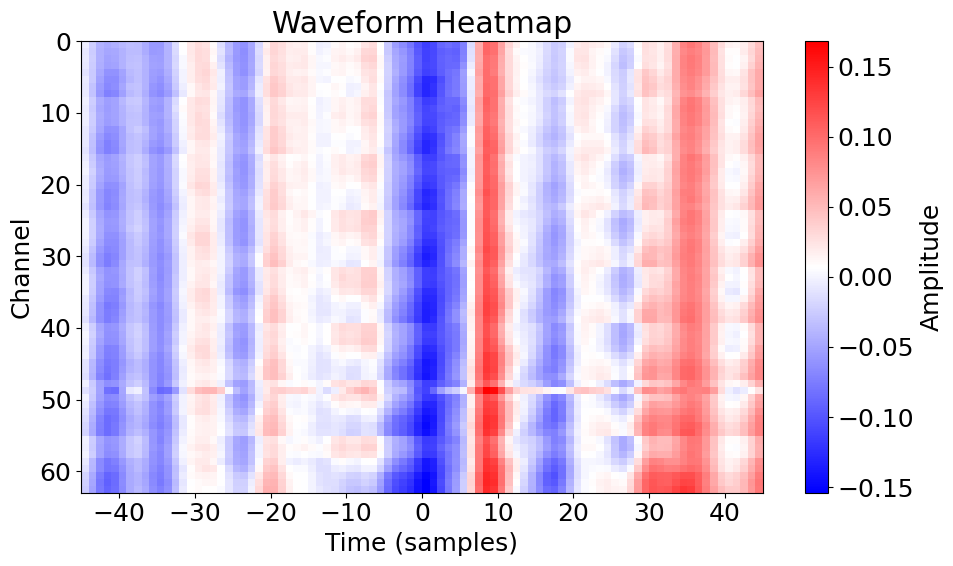

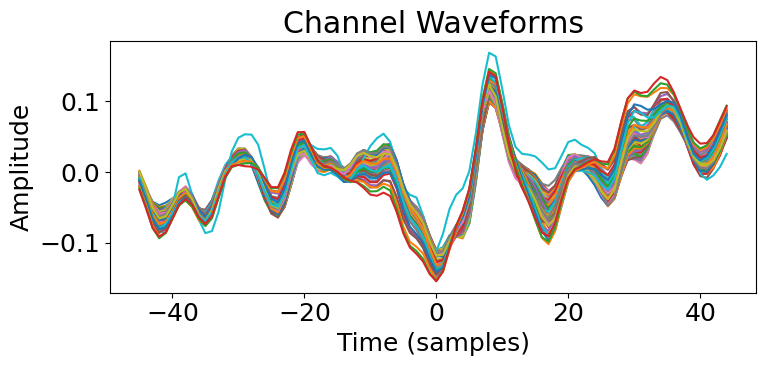

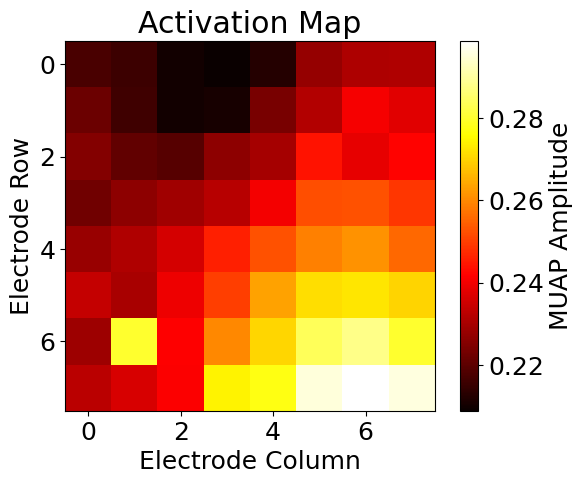

In [177]:
# ---------- パラメータ設定 ----------
window_size = 90  # ウィンドウの長さ（例: 50サンプル）
threshold = 0   # PTPの最大 - 平均がこの値以上なら採用
half_win = window_size // 2

# ---------- EMG信号（例：num_samples × 64） ----------
emg_data = filtered_emg_EP_session1
num_samples = emg_data.shape[0]

# ---------- 出力先 ----------
valid_indices = []

# ---------- 64チャネルすべてに対してピーク検出 ----------
peak_mask = np.zeros(emg_data.shape[0], dtype=bool)

for ch in range(64):
    rms_signal = np.sqrt(emg_data[:,ch]**2)
    peaks, _ = find_peaks(rms_signal, distance=window_size,
                      height=np.mean(rms_signal) + np.std(rms_signal))
    # peaks, _ = find_peaks(emg_data[:, ch], distance=window_size//2, height=np.std(emg_data[:,ch]) * 1)
    peak_mask[peaks] = True  # どこか1チャネルでもピークがあればTrue

# ---------- 全体でのピーク位置で条件を評価 ----------
for t in np.where(peak_mask)[0]:
    if t - half_win < 0 or t + half_win >= num_samples:
        continue  # ウィンドウが境界を超えるならスキップ

    snippet = emg_data[t - half_win : t + half_win, :]  # shape: [window_size, 64]
    ptp_per_ch = snippet.max(axis=0) - snippet.min(axis=0)  # 各チャネルのPTP
    ptp_mean = np.mean(ptp_per_ch)
    ptp_max = np.max(ptp_per_ch)

    if ptp_max - ptp_mean >= threshold:
        valid_indices.append(t)

print(f"検出されたピーク数（条件を満たすもの）: {len(valid_indices)}")

# ----- MUAP波形の切り出し -----
snippets = []
valid_peaks = []
for peak in valid_indices:
    if peak - window_size//2 >= 0 and peak + window_size//2 < emg_data.shape[0]:
        snippet = emg_data[peak - window_size//2 : peak + window_size//2, :]
        snippets.append(snippet)
        valid_peaks.append(peak)

snippets = np.array(snippets)
valid_peaks = np.array(valid_peaks)

for snippet in snippets[:3]:
  # === 波形ヒートマップ ===
  plt.figure(figsize=(10, 6))
  plt.imshow(snippet.T, aspect='auto', cmap='bwr',
              extent=[-window_size//2, window_size//2, 63, 0])
  plt.colorbar(label="Amplitude")
  plt.title(f"Waveform Heatmap")
  plt.xlabel("Time (samples)")
  plt.ylabel("Channel")
  plt.tight_layout()
  plt.show()

  # === チャネル別波形 ===
  plt.figure(figsize=(8, 4))
  for ch in range(snippet.shape[1]):  # 任意チャネル
      plt.plot(np.arange(-window_size//2, window_size//2), snippet[:, ch], label=f'Ch {ch}')
  plt.title(f"Channel Waveforms")
  plt.xlabel("Time (samples)")
  plt.ylabel("Amplitude")
  # plt.legend()
  plt.tight_layout()
  plt.show()

  ptp = np.ptp(snippet,axis=0)
  map_2d = ptp.reshape((8, 8))
  plt.figure()
  plt.imshow(map_2d, cmap='hot', interpolation='nearest')
  plt.colorbar(label='MUAP Amplitude')
  plt.title(f'Activation Map')
  plt.xlabel('Electrode Column')
  plt.ylabel('Electrode Row')
  plt.show()

In [163]:
np.min(features_session1)

-89.99999999999999

In [ ]:
ied = 2
results_df = results_df_session1
#仮想双極電極の電極間距離（cm）
a = ied

n_clusters = results_df['direction_cluster'].nunique()
cluster_colors = get_cluster_colors(n_clusters)

virtual_bipolars = []
labels = []
center_direction = []
for n, direction_cluster in enumerate(sorted(results_df['direction_cluster'].unique())):
  sub_df = results_df[results_df['direction_cluster'] == direction_cluster]
  if sub_df['center_cluster'].count() >= 20 and sub_df['center_x'].std() < 1 and sub_df['center_y'].std() < 1 and sub_df['theta_deg'].std() < 20:
    x, y = sub_df['center_x'].mean(), sub_df['center_y'].mean()
    theta = sub_df['theta_deg'].mean()
    dx, dy = np.cos(np.radians(theta)) * arrow_scale, np.sin(np.radians(theta)) * arrow_scale
    print(f'cluster:{direction_cluster}, x={x}, y={y}, θ={theta}')
    x1 = x - a/2*np.cos(np.radians(theta))
    y1 = y - a/2*np.sin(np.radians(theta))
    x2 = x + a/2*np.cos(np.radians(theta))
    y2 = y + a/2*np.sin(np.radians(theta))
    virtual_bipolars.append([x1, y1, x2, y2])
    labels.append(direction_cluster)
    center_direction.append([x, y, theta])
    # 色で中心クラスタを、マーカーサイズで方向クラスタを示す
    color = cluster_colors[n]
    plt.arrow(x, y, dx, dy, head_width=0.15, color=color, alpha=0.8)
    plt.plot(x, y, 'o', color=color,
              label=f"Center Cl {direction_cluster}" if f"Center Cl {direction_cluster}" not in plt.gca().get_legend_handles_labels()[1] else "")
# ラベル・軸
plt.xlabel("center_x")
plt.ylabel("center_y")
plt.title("2-Stage Clustering of Muscle Fiber Direction")
plt.grid(True)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.axis('equal')
plt.tight_layout()
plt.xlim(0, 7)
plt.ylim(0, 7)
plt.show()

print(len(virtual_bipolars))
# return virtual_bipolars, labels, center_direction

In [ ]:
#分類器
# from sklearn.model_selection import train_test_split
# from sklearn.svm import SVC
# from sklearn.metrics import classification_report, confusion_matrix

X_train = np.array(X_session1).reshape(-1,1)
y_train = np.array(y_session1).reshape(-1,1)
X_test = np.array(X_session2).reshape(-1,1)
y_test = np.array(y_session2).reshape(-1,1)

# データ分割
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# SVMモデル学習
model = SVC(kernel='rbf', probability=True, random_state=0)
model.fit(X_train, y_train)

prob_matrix = model.predict_proba(X_test) # shape: (n_test_samples, n_train_classes)
# === 各テストラベルごとに学習クラスへの平均確率を出力 ===
class_labels = model.classes_  # 学習クラス（例: [0, 1, 2]）

result = []

for test_label in np.unique(y_test):
    idx = y_test.reshape(-1) == test_label
    mean_prob = np.mean(prob_matrix[idx], axis=0)  # 学習クラスへの平均確率
    result.append([test_label] + list(mean_prob))

# === 表形式で表示 ===
columns = ['Test Label'] + [f"P(Train={cls})" for cls in class_labels]
df_result = pd.DataFrame(result, columns=columns)

# import seaborn as sns
# import matplotlib.pyplot as plt

print(df_result)

In [ ]:
max_train_idx = []
for i in range(np.array(result).shape[0]):
j = np.argmax(np.array(result)[i,1:])
max_train_idx.append(j)
# print(max_train_idx)
for k in set(max_train_idx):
if max_train_idx.count(k) >=2:
    idx = max_train_idx == k
    l = np.argmax(np.array(result)[idx, k+1], axis=0)
    max_test_idx = [i for i, j in enumerate(idx) if j == True]
    print(f'result[{max_test_idx[l]},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_test_idx[l]]}')
    center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_test_idx[l], center_direction_session1, center_direction_session2)
    print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')
else:
    print(f'result[{max_train_idx.index(k)},{k+1}], train:{np.unique(y_train)[k]}, test:{np.unique(y_test)[max_train_idx.index(k)]}')
    center_x_diff, center_y_diff, theta_diff = calc_diff(k, max_train_idx.index(k), center_direction_session1, center_direction_session2)
    print(f'x_diff={center_x_diff}, y_diff={center_y_diff}, theta_diff={theta_diff}')

In [343]:
n_subjects = 20
n_gestures = 34
n_trials = 2

for i in range(n_subjects):
    for j in range(n_gestures):
        print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2-1))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2-1))
        print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2))

pr_dataset/subject01_session1/maintenance_preprocess_sample1
pr_dataset/subject01_session1/maintenance_preprocess_sample2
pr_dataset/subject01_session2/maintenance_preprocess_sample1
pr_dataset/subject01_session2/maintenance_preprocess_sample2
pr_dataset/subject01_session1/maintenance_preprocess_sample3
pr_dataset/subject01_session1/maintenance_preprocess_sample4
pr_dataset/subject01_session2/maintenance_preprocess_sample3
pr_dataset/subject01_session2/maintenance_preprocess_sample4
pr_dataset/subject01_session1/maintenance_preprocess_sample5
pr_dataset/subject01_session1/maintenance_preprocess_sample6
pr_dataset/subject01_session2/maintenance_preprocess_sample5
pr_dataset/subject01_session2/maintenance_preprocess_sample6
pr_dataset/subject01_session1/maintenance_preprocess_sample7
pr_dataset/subject01_session1/maintenance_preprocess_sample8
pr_dataset/subject01_session2/maintenance_preprocess_sample7
pr_dataset/subject01_session2/maintenance_preprocess_sample8
pr_dataset/subject01_ses

In [ ]:
n_subjects = 20
n_gestures = 34
n_trials = 2

for i in range(n_subjects):
    for j in range(n_gestures):
        for k in range(n_trials):
            print('pr_dataset/subject{:02}'.format(i+1) + '_session1/maintenance_preprocess_sample'+str((j+1)*2+(k-1)))
            print('pr_dataset/subject{:02}'.format(i+1) + '_session2/maintenance_preprocess_sample'+str((j+1)*2+(k-1)))

pr_dataset/subject01_session1/maintenance_preprocess_sample1
pr_dataset/subject01_session2/maintenance_preprocess_sample1
pr_dataset/subject01_session1/maintenance_preprocess_sample2
pr_dataset/subject01_session2/maintenance_preprocess_sample2
pr_dataset/subject01_session1/maintenance_preprocess_sample3
pr_dataset/subject01_session2/maintenance_preprocess_sample3
pr_dataset/subject01_session1/maintenance_preprocess_sample4
pr_dataset/subject01_session2/maintenance_preprocess_sample4
pr_dataset/subject01_session1/maintenance_preprocess_sample5
pr_dataset/subject01_session2/maintenance_preprocess_sample5
pr_dataset/subject01_session1/maintenance_preprocess_sample6
pr_dataset/subject01_session2/maintenance_preprocess_sample6
pr_dataset/subject01_session1/maintenance_preprocess_sample7
pr_dataset/subject01_session2/maintenance_preprocess_sample7
pr_dataset/subject01_session1/maintenance_preprocess_sample8
pr_dataset/subject01_session2/maintenance_preprocess_sample8
pr_dataset/subject01_ses

検出されたピーク数（条件を満たすもの）: 558


C:\Users\takeu\AppData\Local\Temp\ipykernel_7044\175111030.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap(cmap_name, n_clusters)  # 'tab20', 'nipy_spectral', etc.


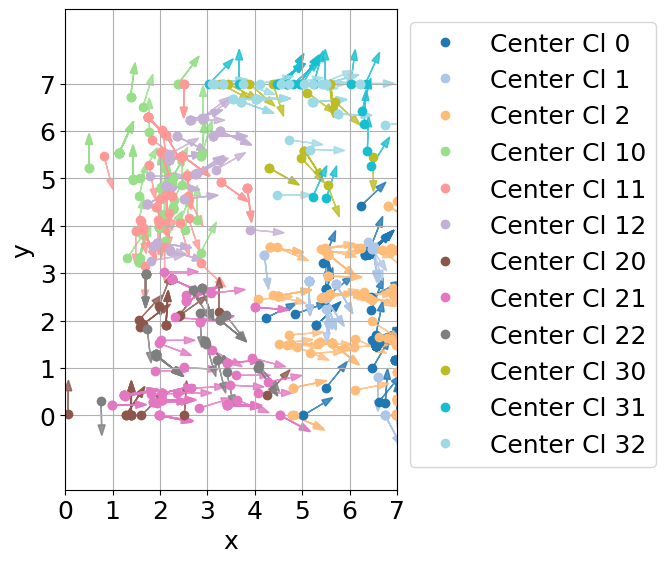

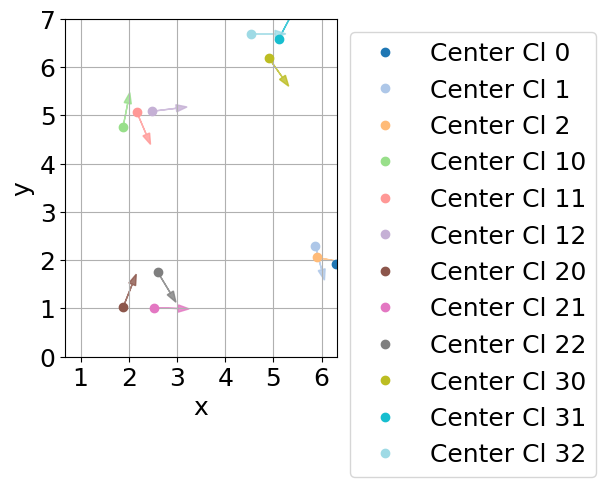

In [84]:
if n_virtual_bipolars_session1 >= 1 and n_virtual_bipolars_session2 >= 1:
    result, y_train, y_test = SVC_classifier(X_session1, y_session1, X_session2, y_session2)
    diff = diff_analyzer(result, y_train, y_test, center_direction_session1, center_direction_session2)
else:
    diff = [None]

c:\Users\takeu\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [85]:
diff

[{'train': 0, 'test': 0, 'x_diff': 0.0, 'y_diff': 0.0, 'theta_diff': 0.0},
 {'train': 1, 'test': 1, 'x_diff': 0.0, 'y_diff': 0.0, 'theta_diff': 0.0},
 {'train': 10,
  'test': 30,
  'x_diff': -0.7698608525955866,
  'y_diff': -5.9139285467543345,
  'theta_diff': -123.69676232738203},
 {'train': 11,
  'test': 21,
  'x_diff': -1.1627351521386942,
  'y_diff': -3.0324907011129874,
  'theta_diff': 66.76391593118885},
 {'train': 12,
  'test': 2,
  'x_diff': 2.642377943054742,
  'y_diff': -3.879479897623143,
  'theta_diff': 64.97916346947684},
 {'train': 20,
  'test': 22,
  'x_diff': 0.26268270012220274,
  'y_diff': 0.1764151822457225,
  'theta_diff': -88.01811066692053},
 {'train': 30,
  'test': 32,
  'x_diff': 0.6036834505688065,
  'y_diff': 0.04940618051904622,
  'theta_diff': 107.4485991820015},
 {'train': 32,
  'test': 10,
  'x_diff': 0.1661774020267801,
  'y_diff': 5.864522366235288,
  'theta_diff': 16.248163145380524}]

In [321]:
n_virtual_bipolars_session2

0

In [338]:
diffs

[{'diff': [{'train': 0,
    'test': 30,
    'x_diff': 3.8259491881339103,
    'y_diff': 3.593425777750928,
    'theta_diff': 132.32900987559782},
   {'train': 30,
    'test': 10,
    'x_diff': -0.02485568984674824,
    'y_diff': -0.05747863767190342,
    'theta_diff': 9.093665741959128}],
  'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1',
   'pr_dataset/subject01_session2/maintenance_preprocess_sample1'],
  'electrode_place': 'ED'},
 {'diff': [{'train': 20,
    'test': 21,
    'x_diff': 3.9834823697861856,
    'y_diff': 2.5134437058997183,
    'theta_diff': -8.075040434084851},
   {'train': 30,
    'test': 31,
    'x_diff': 0.7655725323054208,
    'y_diff': 0.15258456651748098,
    'theta_diff': -6.914685794504898},
   {'train': 32,
    'test': 11,
    'x_diff': 3.10617847342346,
    'y_diff': 1.6273900614522736,
    'theta_diff': 14.760163601038961}],
  'file_name': ['pr_dataset/subject01_session1/maintenance_preprocess_sample1',
   'pr_dataset/subject01_s